# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [22]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined.float()

In [23]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [16]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [17]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [18]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [19]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [20]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0393493381738663, discriminator loss: 0.3037570063881576


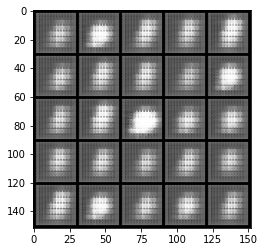

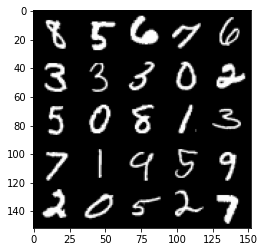

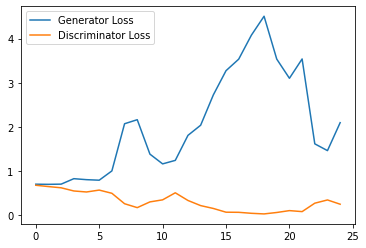

Step 1000: Generator loss: 4.182625194072723, discriminator loss: 0.05292175163142383


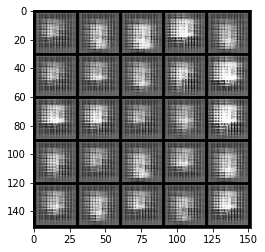

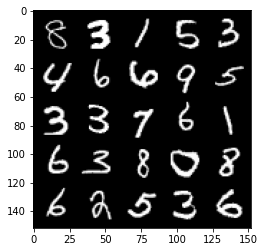

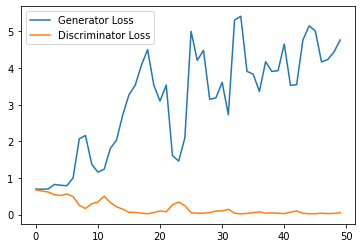

Step 1500: Generator loss: 5.085240506649018, discriminator loss: 0.03640379298012704


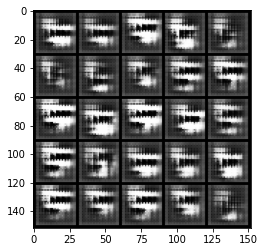

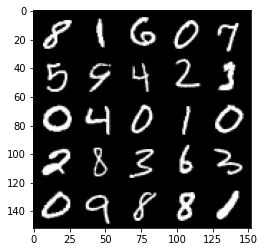

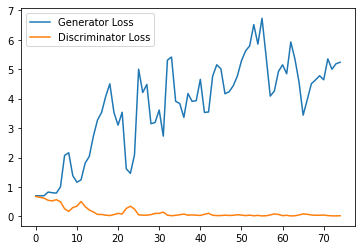

Step 2000: Generator loss: 5.334306644916534, discriminator loss: 0.032179342394694686


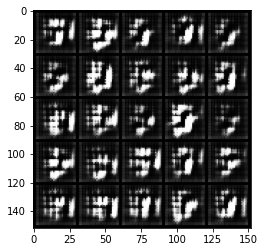

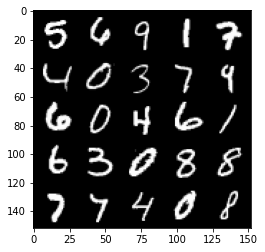

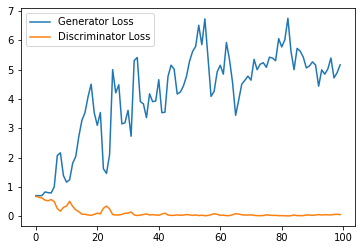

Step 2500: Generator loss: 4.101315028190613, discriminator loss: 0.08032787555083633


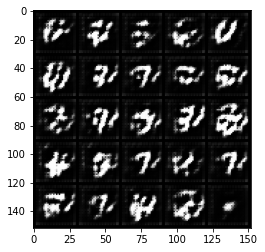

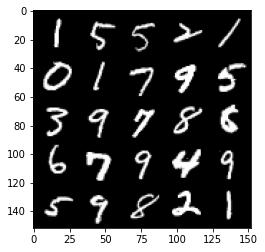

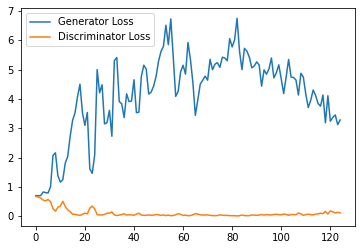

Step 3000: Generator loss: 2.8732870264053343, discriminator loss: 0.21910571996867656


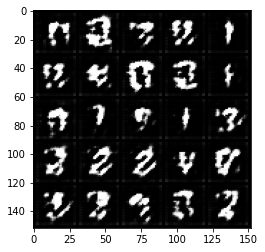

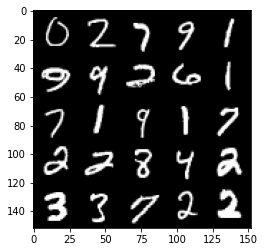

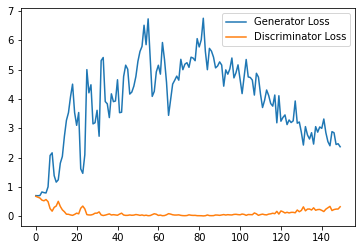

Step 3500: Generator loss: 2.536293340921402, discriminator loss: 0.2798384144604206


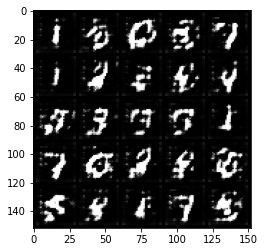

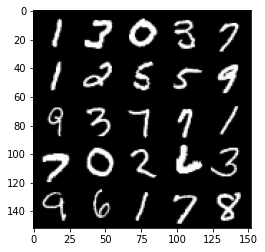

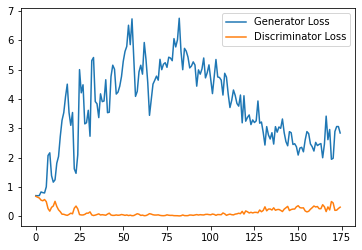

Step 4000: Generator loss: 2.2793108682632446, discriminator loss: 0.2832173758149147


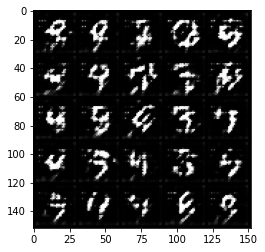

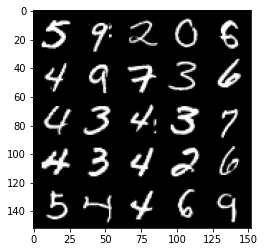

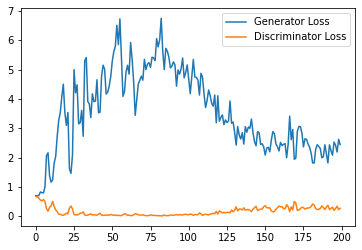

Step 4500: Generator loss: 2.277671222925186, discriminator loss: 0.2944468200802803


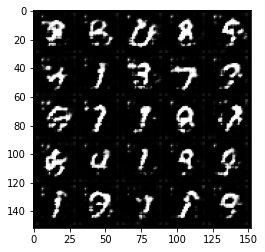

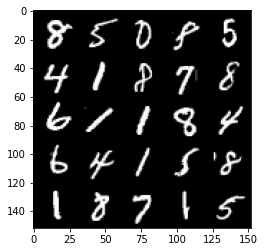

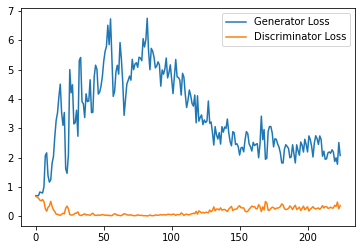

Step 5000: Generator loss: 2.191251726150513, discriminator loss: 0.31193018378317355


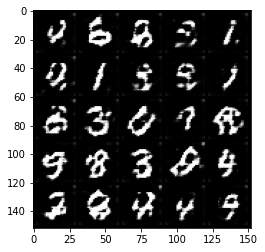

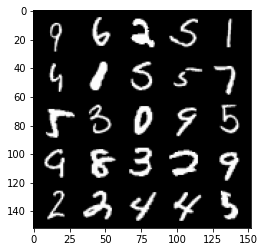

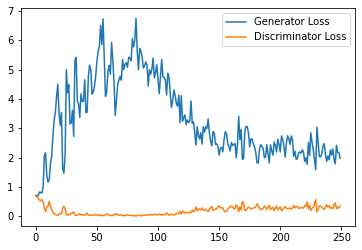

Step 5500: Generator loss: 2.110767257928848, discriminator loss: 0.3306693795621395


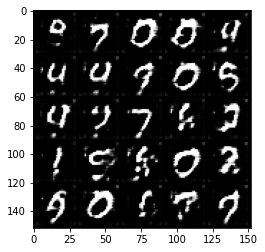

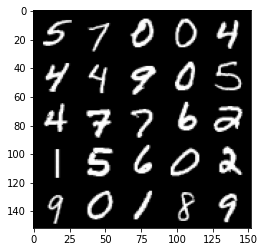

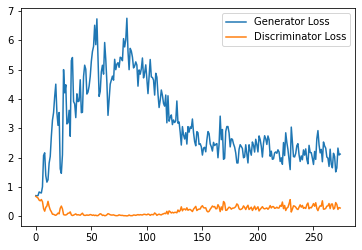

Step 6000: Generator loss: 1.8422911586761475, discriminator loss: 0.33403434899449347


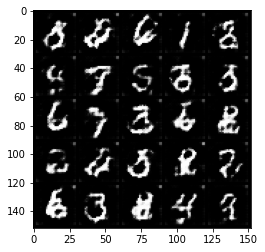

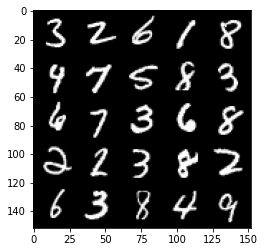

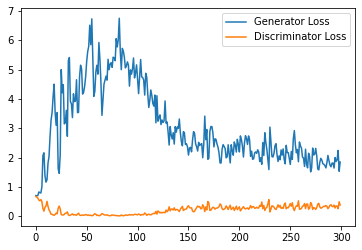

Step 6500: Generator loss: 1.850196100950241, discriminator loss: 0.389980753839016


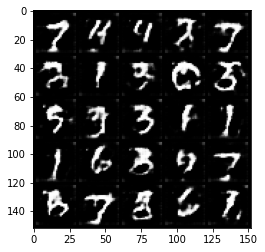

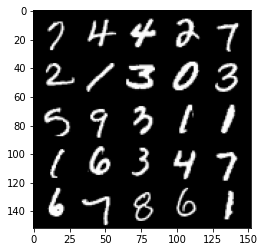

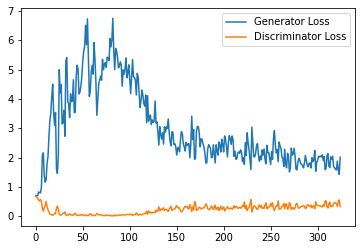

Step 7000: Generator loss: 1.7216887667179108, discriminator loss: 0.40324356773495673


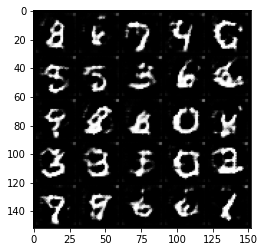

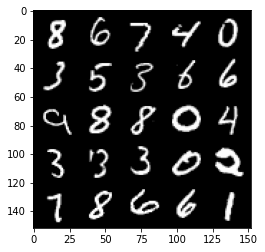

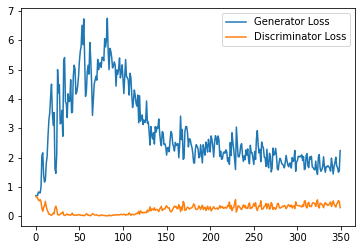

Step 7500: Generator loss: 1.548269507408142, discriminator loss: 0.44219196611642836


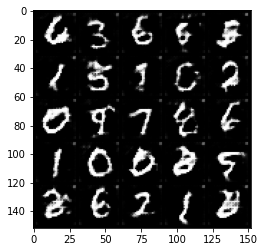

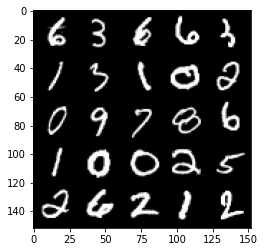

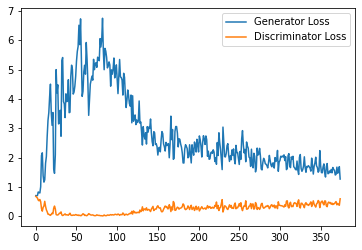

Step 8000: Generator loss: 1.5681984989643096, discriminator loss: 0.45585594183206557


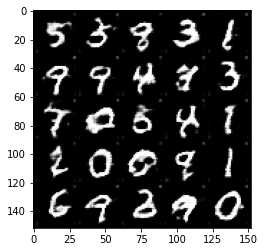

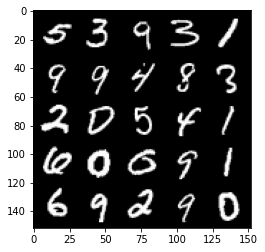

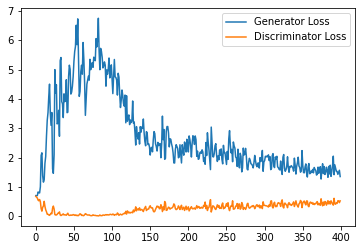

Step 8500: Generator loss: 1.3924425011873245, discriminator loss: 0.4665192597508431


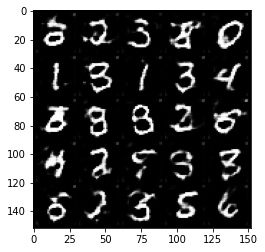

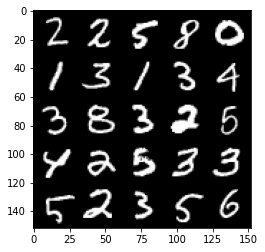

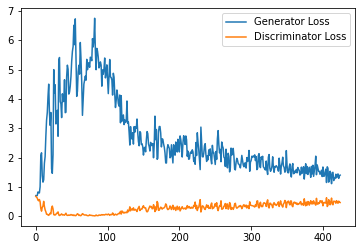

Step 9000: Generator loss: 1.4155103369951247, discriminator loss: 0.49693519496917726


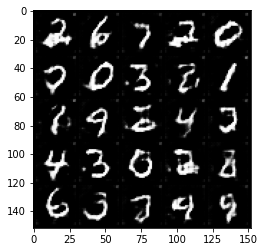

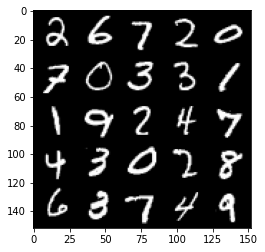

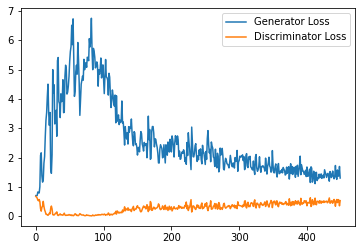

Step 9500: Generator loss: 1.4213372131586075, discriminator loss: 0.5016257868409156


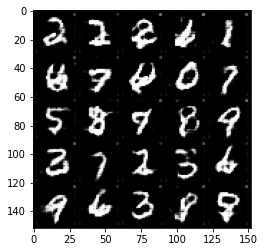

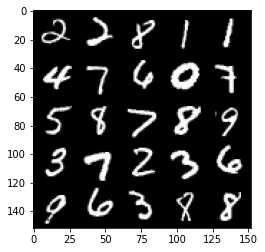

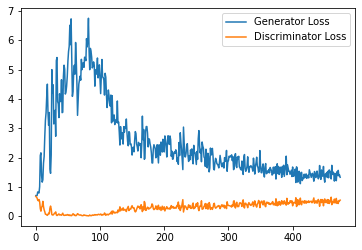

Step 10000: Generator loss: 1.3380009553432464, discriminator loss: 0.5124982109665871


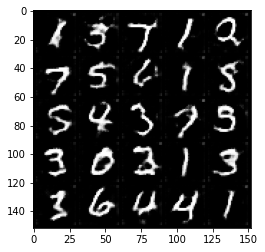

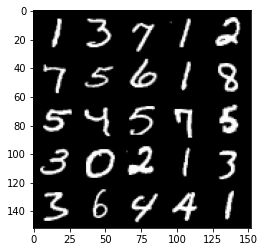

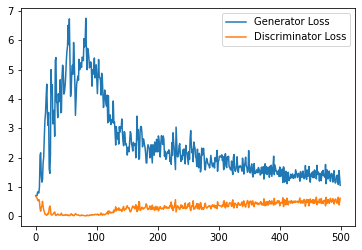

Step 10500: Generator loss: 1.3299366654157638, discriminator loss: 0.5047923316359519


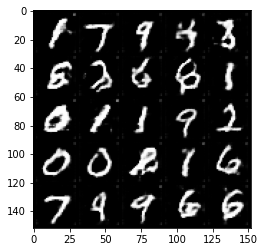

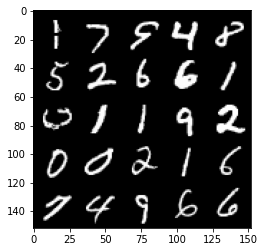

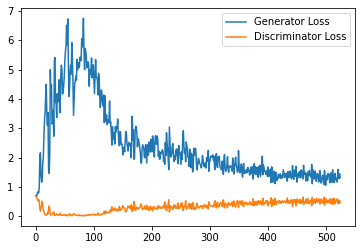

Step 11000: Generator loss: 1.2933412724733353, discriminator loss: 0.5086533691883087


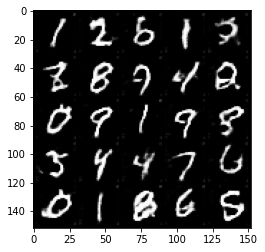

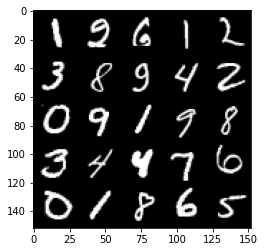

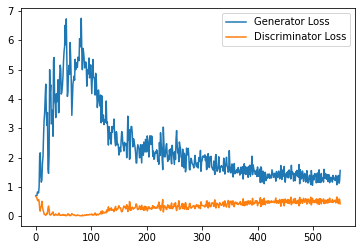

Step 11500: Generator loss: 1.232625776529312, discriminator loss: 0.5196866042613983


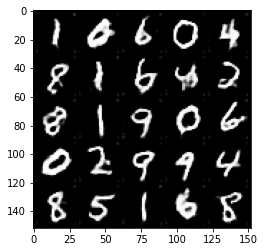

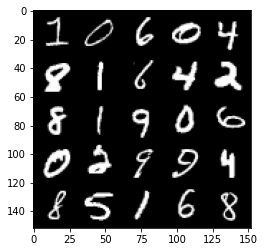

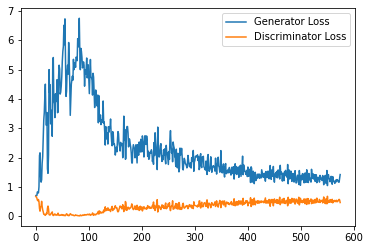

Step 12000: Generator loss: 1.2507987480163574, discriminator loss: 0.528288428068161


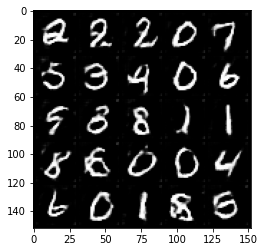

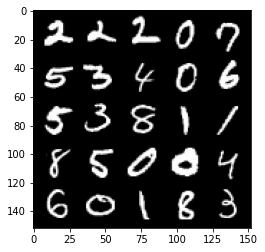

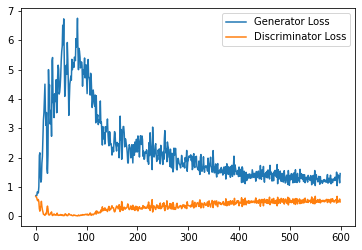

Step 12500: Generator loss: 1.2178258615732194, discriminator loss: 0.5487037418484688


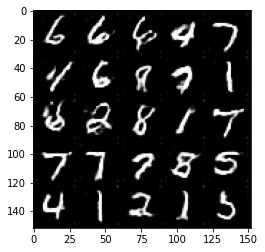

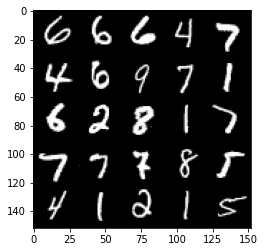

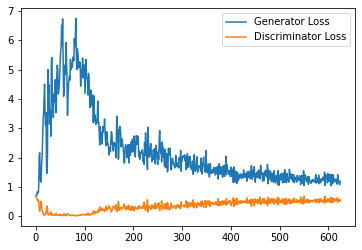

Step 13000: Generator loss: 1.1376221165657043, discriminator loss: 0.5501486624479294


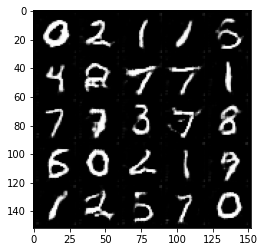

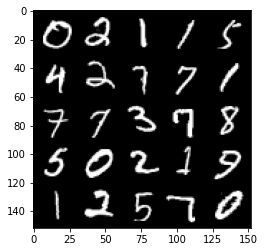

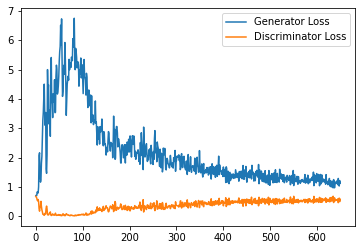

Step 13500: Generator loss: 1.1393287570476531, discriminator loss: 0.5593624197840691


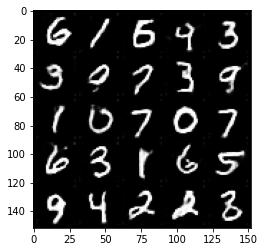

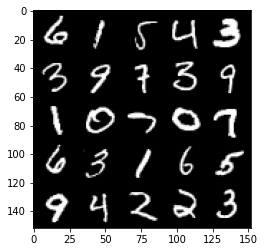

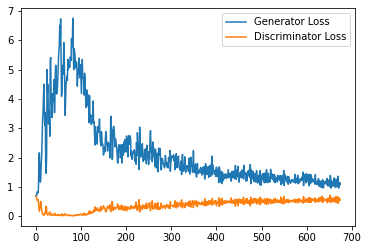

Step 14000: Generator loss: 1.0970793213844299, discriminator loss: 0.5719280829429626


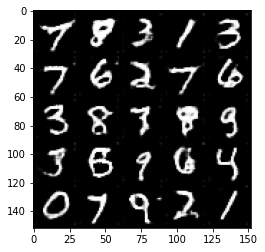

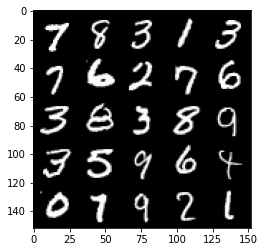

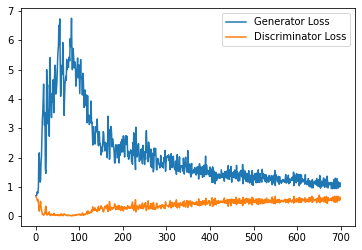

Step 14500: Generator loss: 1.1581107399463653, discriminator loss: 0.5726374949812889


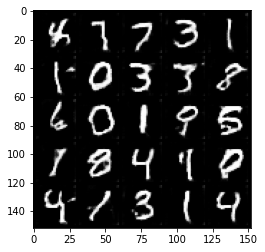

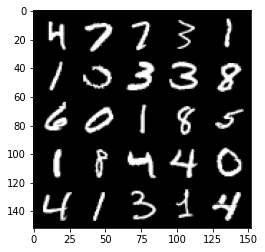

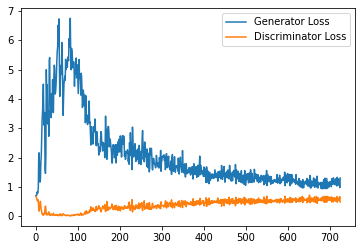

Step 15000: Generator loss: 1.0837656009197234, discriminator loss: 0.5850850178599357


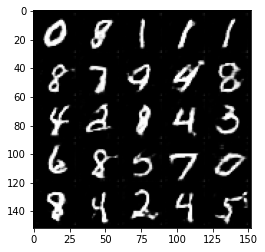

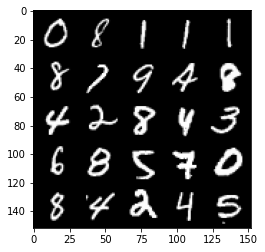

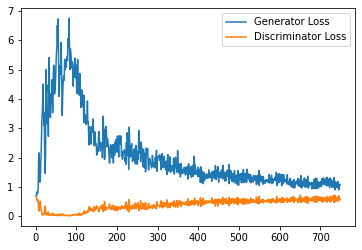

Step 15500: Generator loss: 1.1154541517496108, discriminator loss: 0.5847375075817108


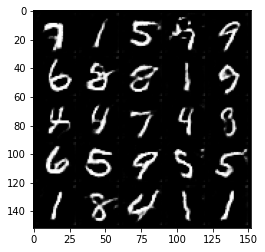

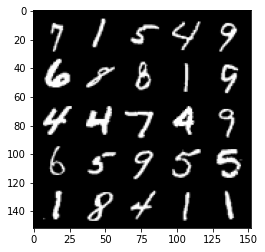

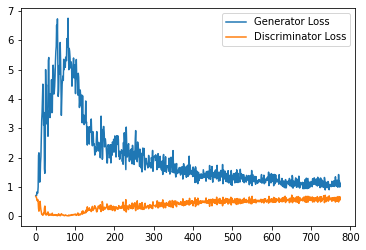

Step 16000: Generator loss: 1.0640724546909333, discriminator loss: 0.5860363434553146


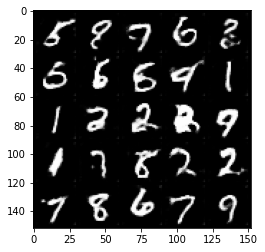

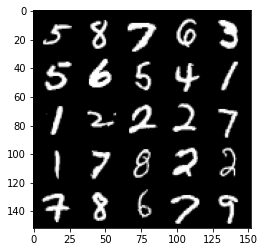

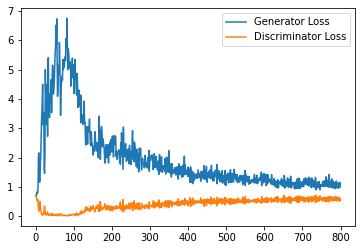

Step 16500: Generator loss: 1.0498583670854569, discriminator loss: 0.5903185274004936


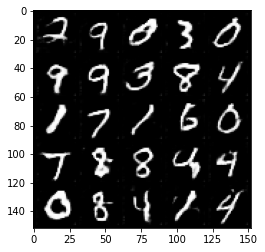

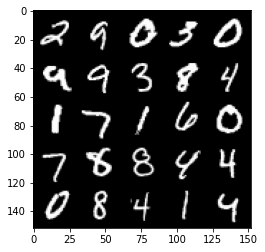

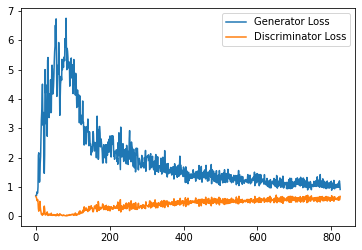

Step 17000: Generator loss: 1.0818624898195266, discriminator loss: 0.592992341697216


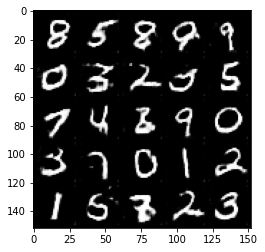

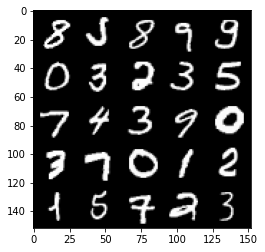

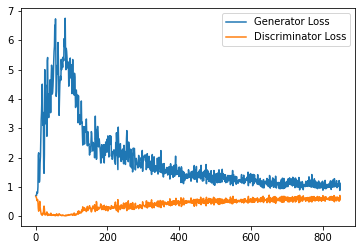

Step 17500: Generator loss: 1.0416038421392442, discriminator loss: 0.5961325320601464


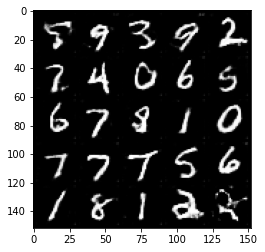

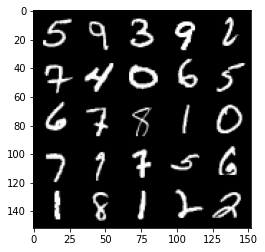

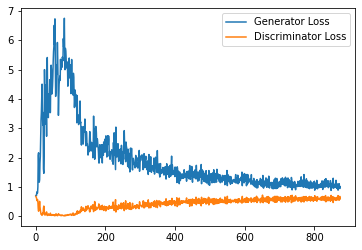

Step 18000: Generator loss: 1.0289580341577529, discriminator loss: 0.5939931019544601


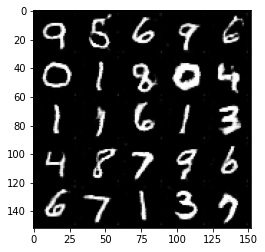

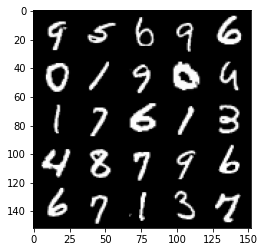

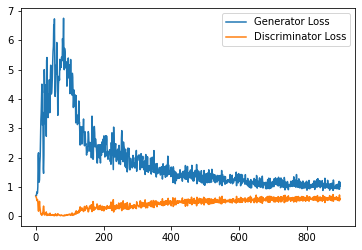

Step 18500: Generator loss: 1.020676559448242, discriminator loss: 0.5979398980736732


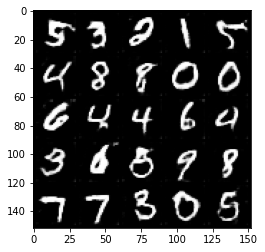

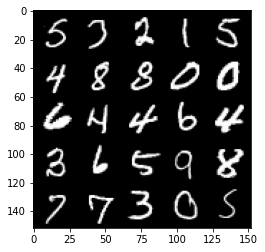

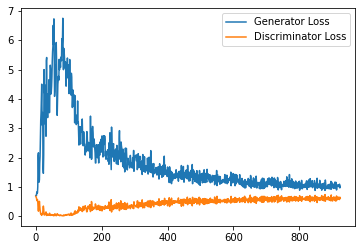

Step 19000: Generator loss: 1.0452545763254166, discriminator loss: 0.599415126144886


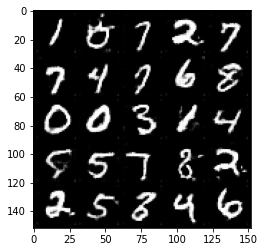

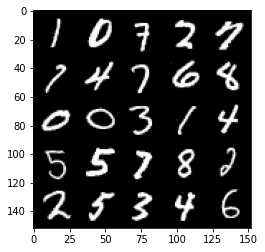

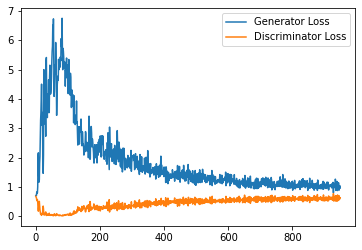

Step 19500: Generator loss: 1.0115183533430099, discriminator loss: 0.5970513885617256


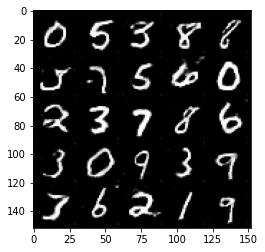

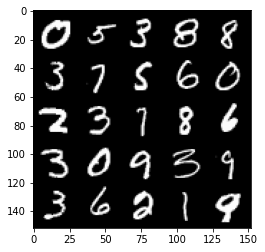

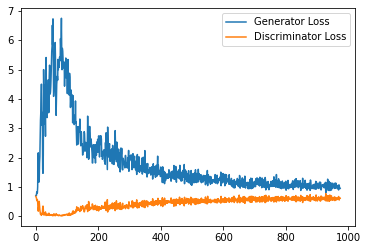

Step 20000: Generator loss: 0.9835532667636872, discriminator loss: 0.5972823120951652


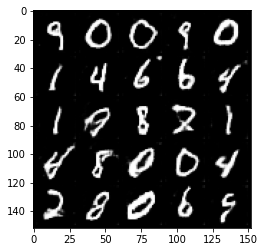

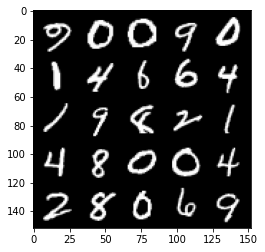

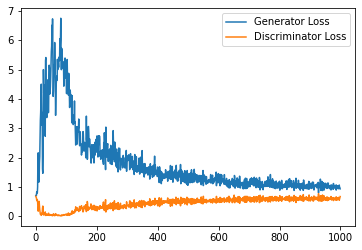

Step 20500: Generator loss: 1.0430809890031814, discriminator loss: 0.60161714220047


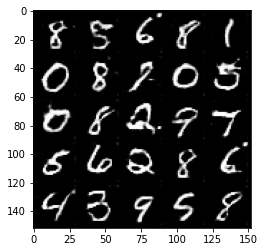

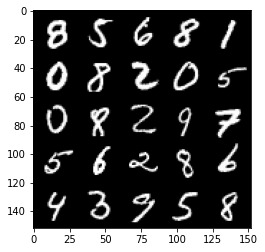

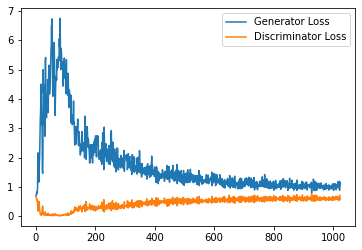

Step 21000: Generator loss: 1.0010297589302064, discriminator loss: 0.6044268956184388


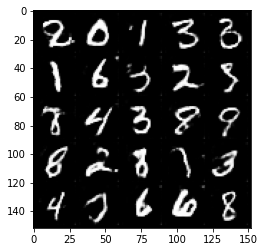

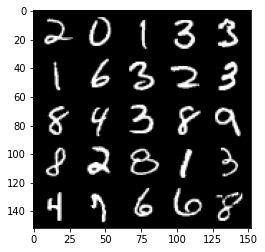

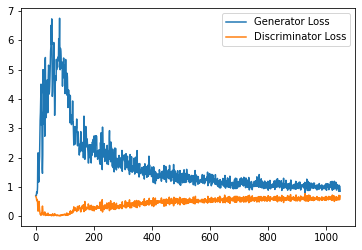

Step 21500: Generator loss: 0.9931220527887344, discriminator loss: 0.6053069204688072


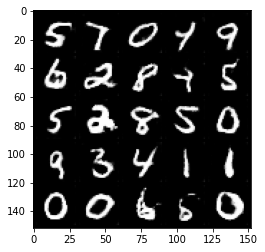

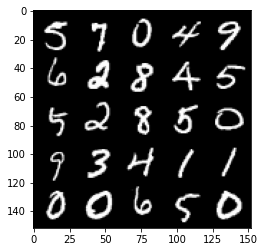

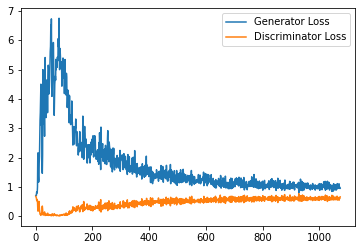

Step 22000: Generator loss: 1.0167441798448562, discriminator loss: 0.6076484652757644


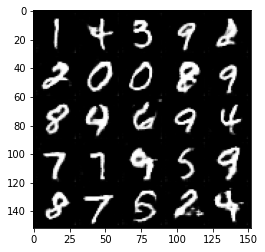

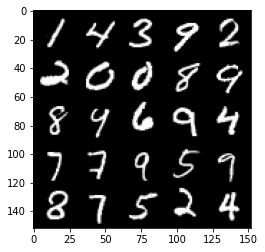

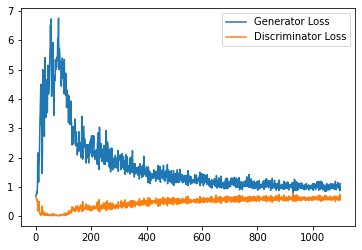

Step 22500: Generator loss: 0.9972996846437454, discriminator loss: 0.6078282346725464


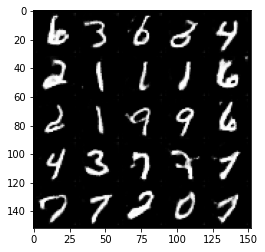

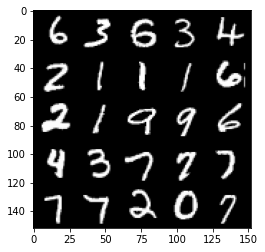

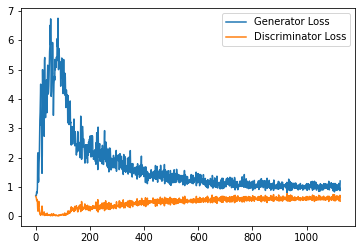

Step 23000: Generator loss: 0.967417272567749, discriminator loss: 0.6114163111448288


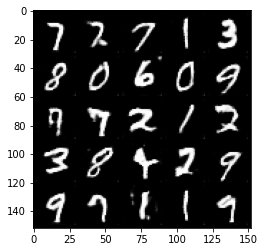

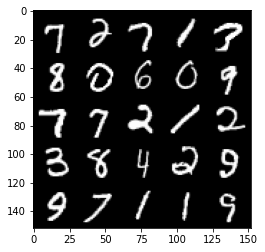

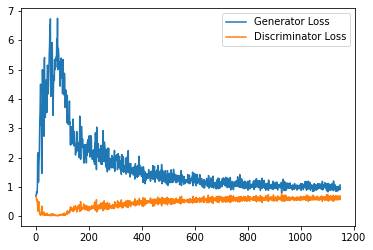

Step 23500: Generator loss: 0.9554279366731644, discriminator loss: 0.610500495314598


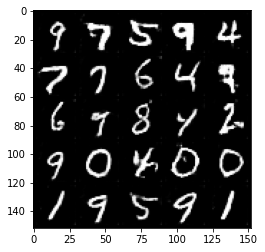

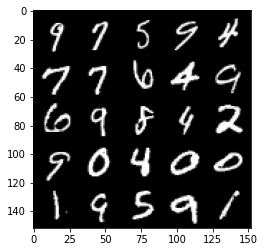

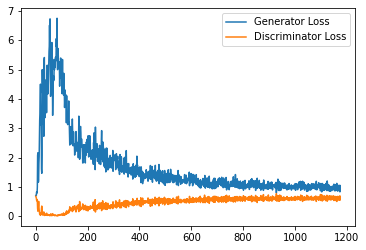

Step 24000: Generator loss: 0.9638812465667724, discriminator loss: 0.611086266875267


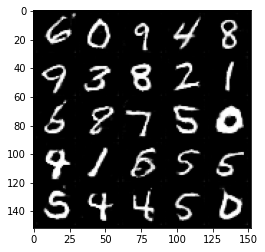

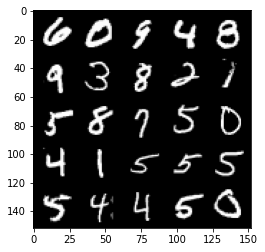

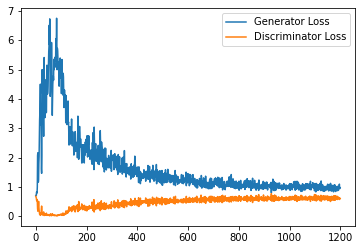

Step 24500: Generator loss: 0.9516556651592255, discriminator loss: 0.6112795660495758


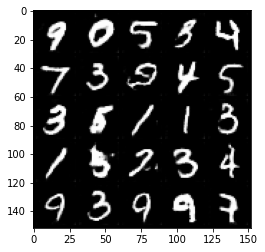

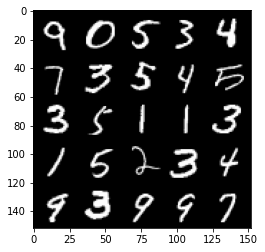

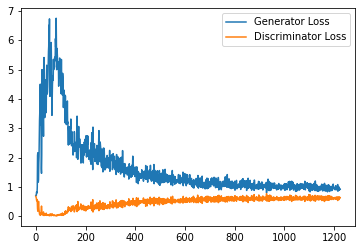

Step 25000: Generator loss: 0.9514681794643403, discriminator loss: 0.6130785541534424


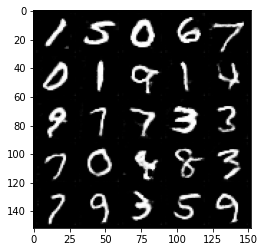

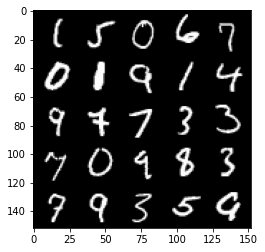

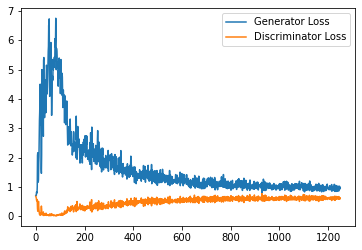

Step 25500: Generator loss: 0.9848713561296463, discriminator loss: 0.6156010817885399


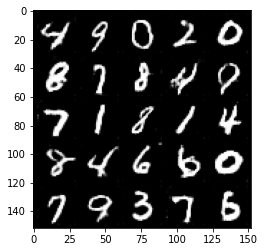

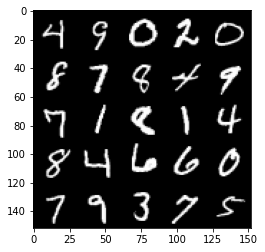

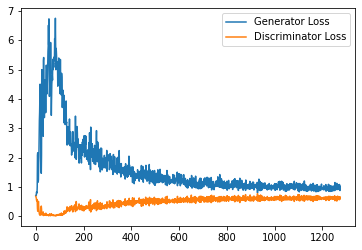

Step 26000: Generator loss: 0.9947333685159683, discriminator loss: 0.6175123584270478


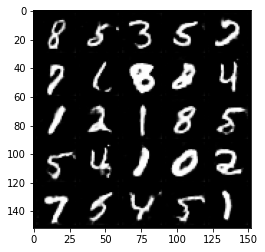

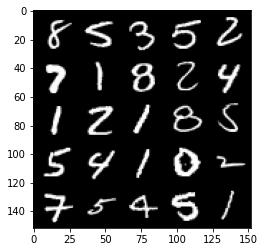

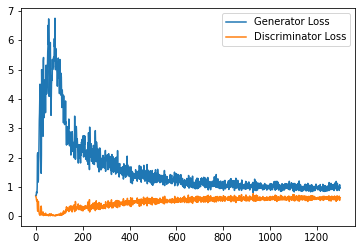

Step 26500: Generator loss: 0.9423118938207626, discriminator loss: 0.6193438746333122


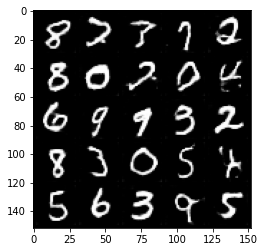

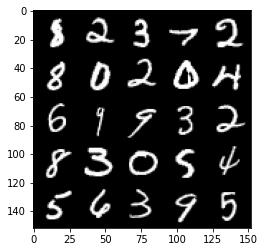

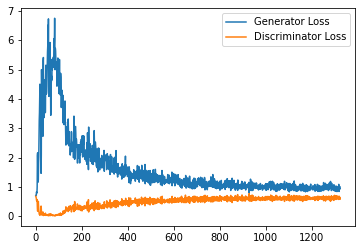

Step 27000: Generator loss: 0.9294967354536057, discriminator loss: 0.6175811183452606


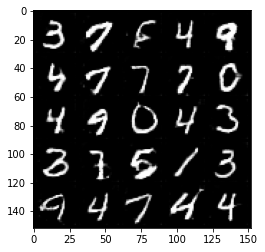

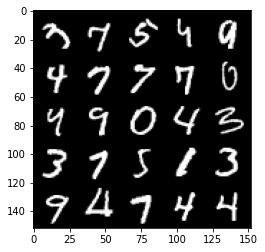

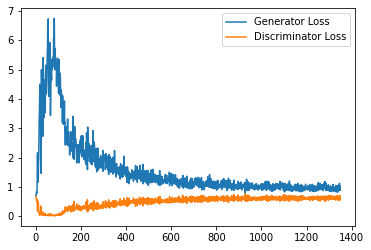

Step 27500: Generator loss: 0.9270553679466248, discriminator loss: 0.6210332023501396


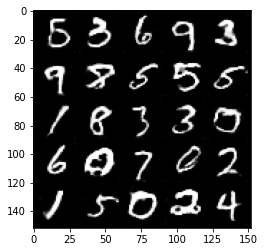

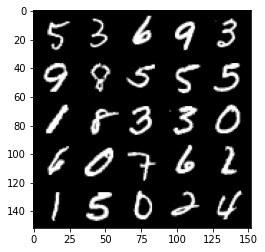

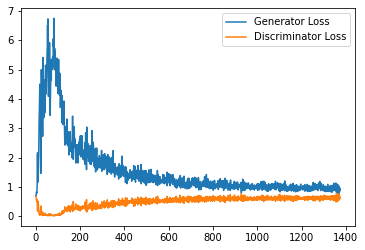

Step 28000: Generator loss: 0.9376263189315795, discriminator loss: 0.6195747932195663


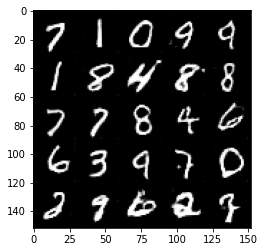

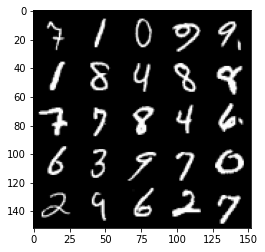

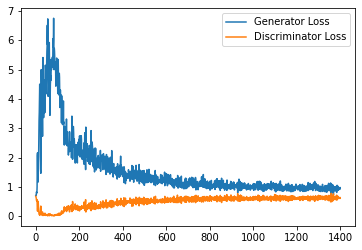

Step 28500: Generator loss: 0.9403334003686905, discriminator loss: 0.6243538853526115


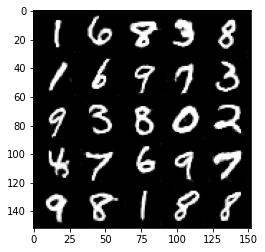

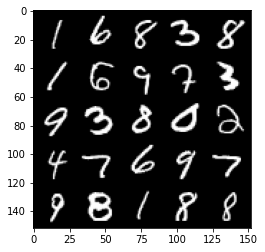

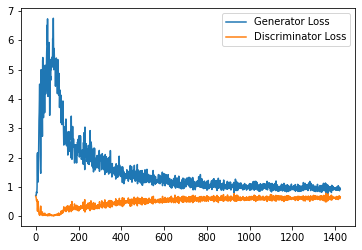

Step 29000: Generator loss: 0.9326877082586289, discriminator loss: 0.6214847671985626


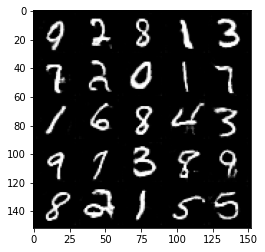

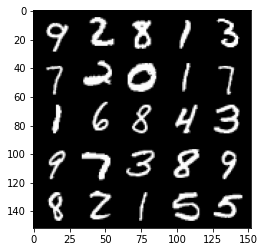

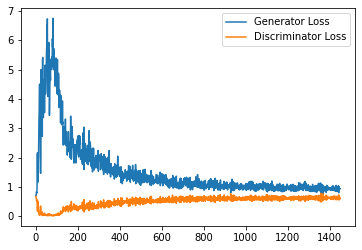

Step 29500: Generator loss: 0.9291804504394531, discriminator loss: 0.6239148763418197


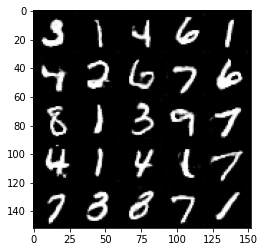

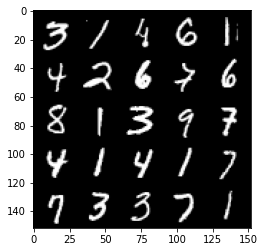

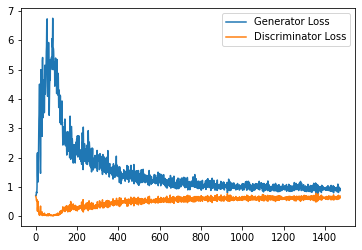

Step 30000: Generator loss: 0.9136567095518112, discriminator loss: 0.6225424904823303


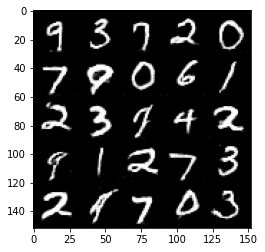

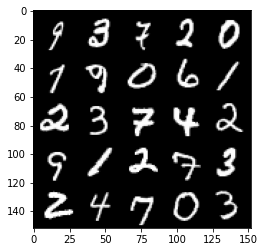

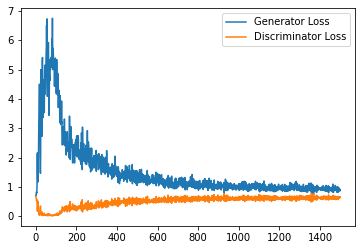

Step 30500: Generator loss: 0.9361680721044541, discriminator loss: 0.6243004269599914


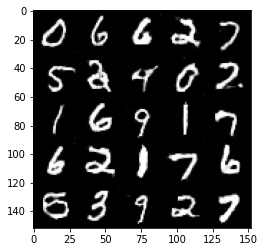

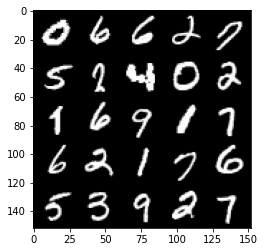

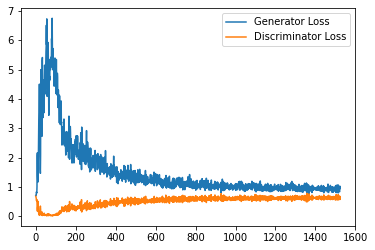

Step 31000: Generator loss: 0.9192409375905991, discriminator loss: 0.627190013885498


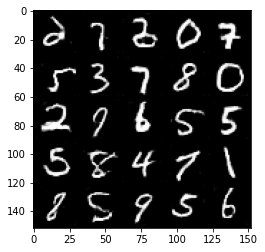

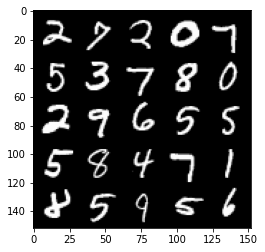

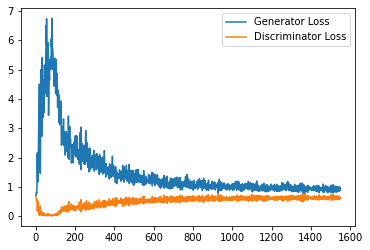

Step 31500: Generator loss: 0.9170372003316879, discriminator loss: 0.628163929104805


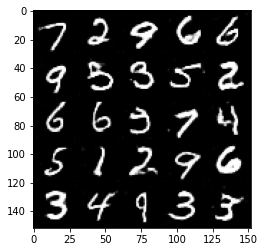

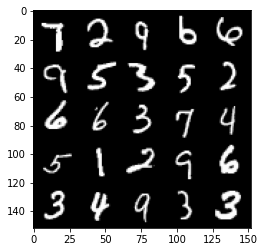

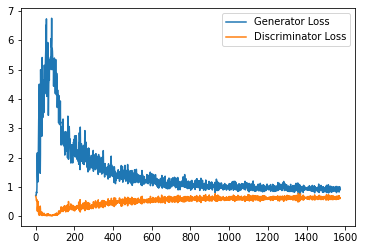

Step 32000: Generator loss: 0.9175027409791946, discriminator loss: 0.6271132910251618


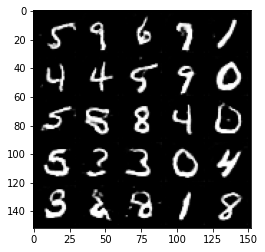

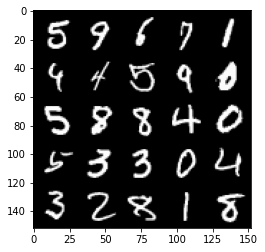

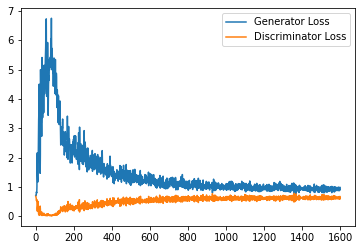

Step 32500: Generator loss: 0.9390178208351135, discriminator loss: 0.6247325007915496


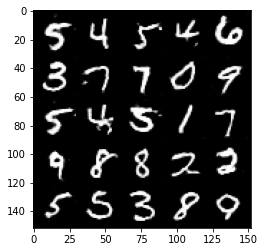

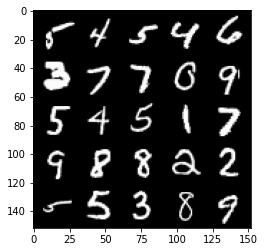

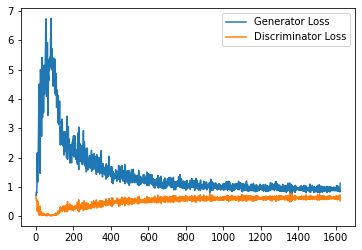

Step 33000: Generator loss: 0.9122309174537658, discriminator loss: 0.629466979265213


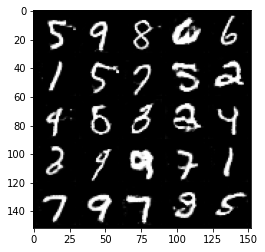

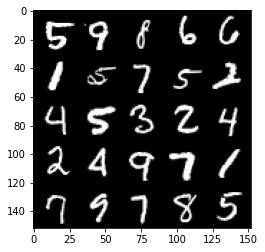

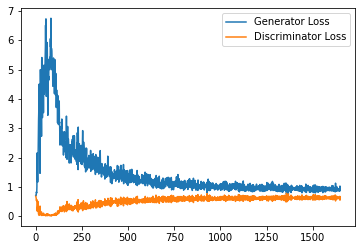

Step 33500: Generator loss: 0.9237649257183075, discriminator loss: 0.6286986625194549


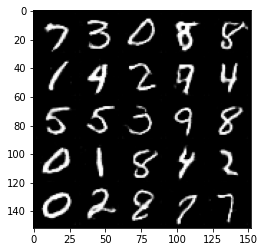

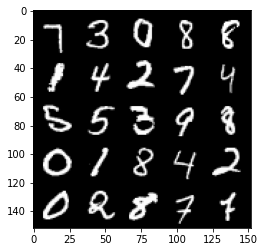

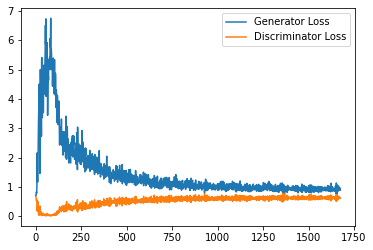

Step 34000: Generator loss: 0.8923623658418656, discriminator loss: 0.6296325330734253


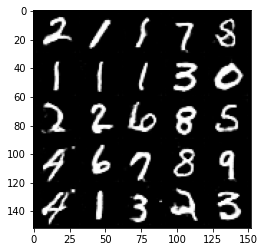

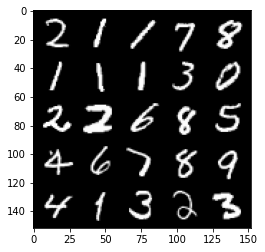

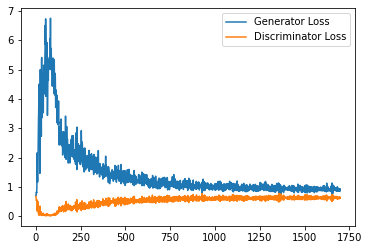

Step 34500: Generator loss: 0.9232840497493744, discriminator loss: 0.6265883069634438


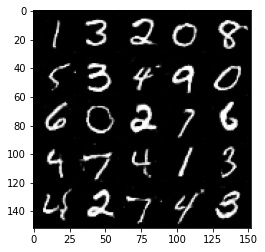

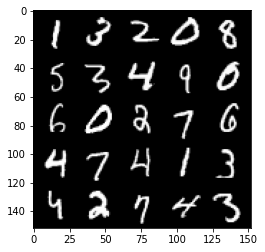

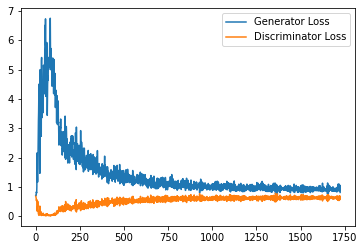

Step 35000: Generator loss: 0.9094272526502609, discriminator loss: 0.6299417489767074


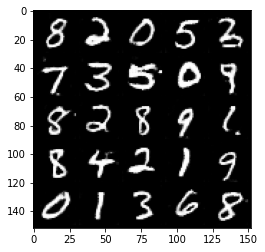

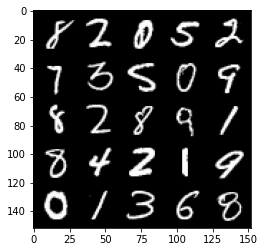

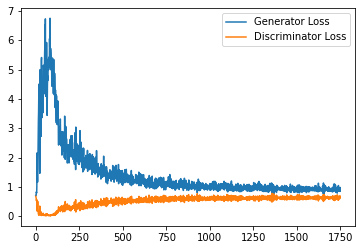

Step 35500: Generator loss: 0.8931702572107315, discriminator loss: 0.6286024861335754


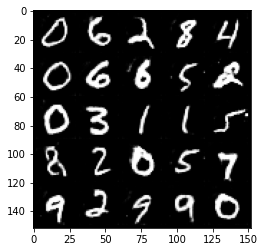

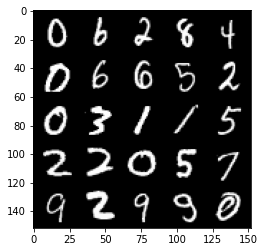

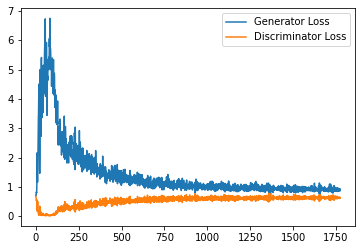

Step 36000: Generator loss: 0.9131086596250534, discriminator loss: 0.6311066623926163


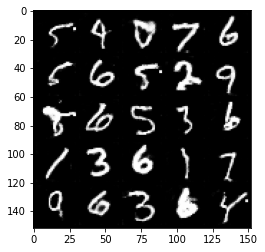

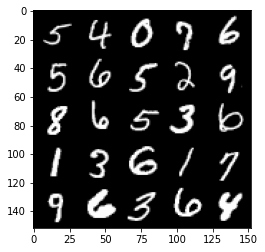

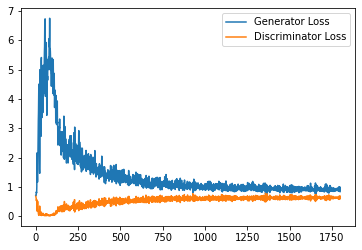

Step 36500: Generator loss: 0.9184531655311584, discriminator loss: 0.6259009948968888


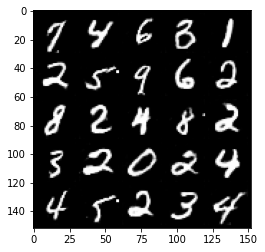

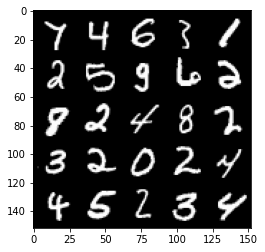

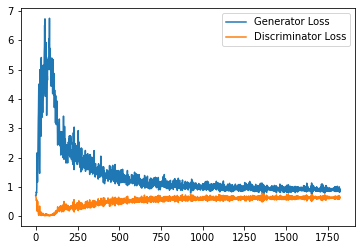

Step 37000: Generator loss: 0.9281741681098938, discriminator loss: 0.6340164166688919


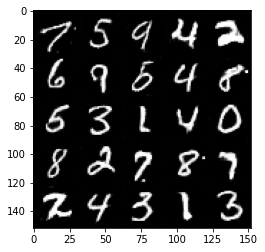

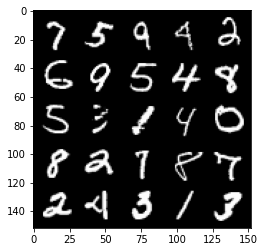

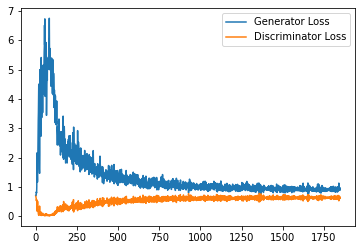

Step 37500: Generator loss: 0.9004278482198715, discriminator loss: 0.6346154203414917


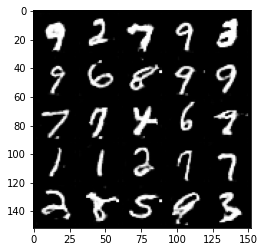

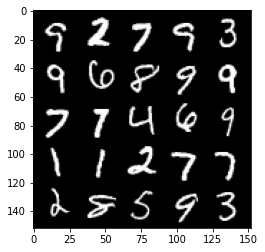

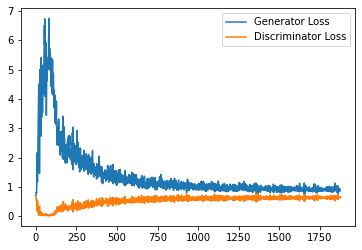

Step 38000: Generator loss: 0.9003048706054687, discriminator loss: 0.6322267032861709


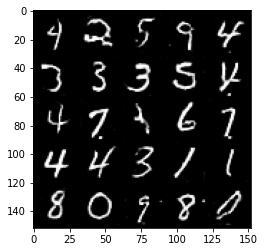

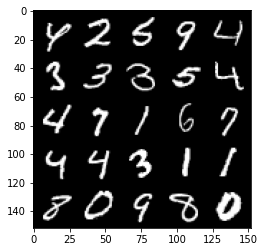

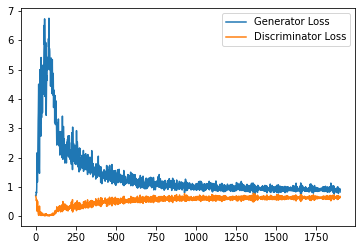

Step 38500: Generator loss: 0.878911429643631, discriminator loss: 0.6296360359191895


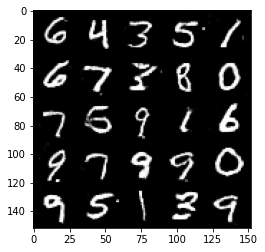

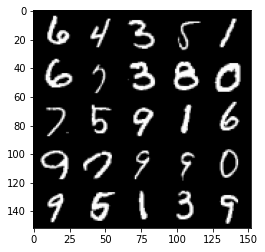

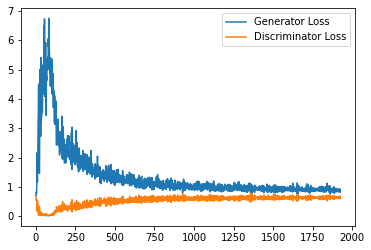

Step 39000: Generator loss: 0.9282963596582413, discriminator loss: 0.6266061401367188


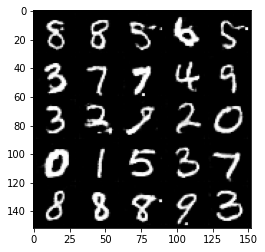

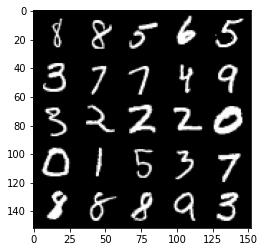

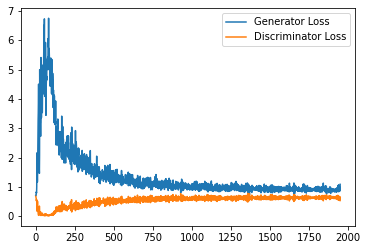

Step 39500: Generator loss: 0.9113190602064133, discriminator loss: 0.6336193137168884


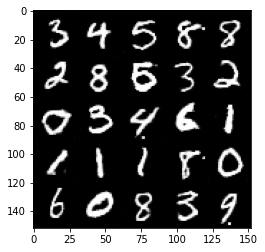

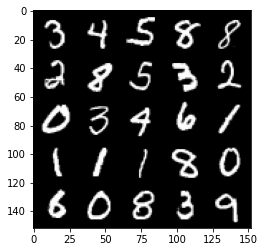

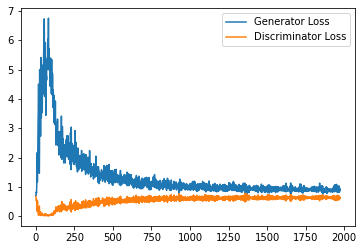

Step 40000: Generator loss: 0.8936744335889816, discriminator loss: 0.6286607913374901


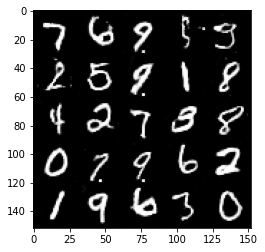

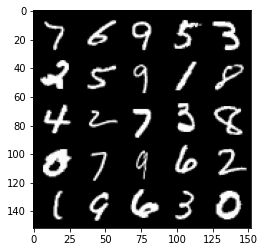

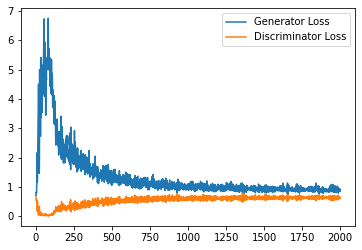

Step 40500: Generator loss: 0.9056420195102691, discriminator loss: 0.6268262178897858


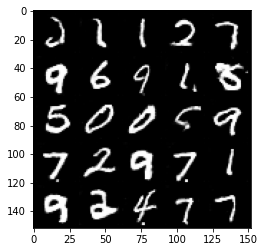

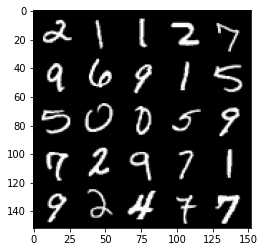

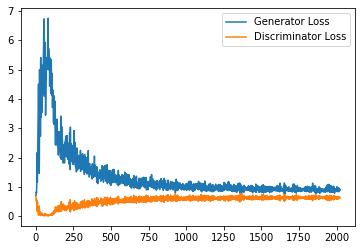

Step 41000: Generator loss: 0.9015172003507614, discriminator loss: 0.6341924368143081


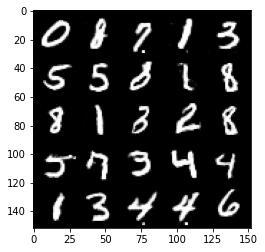

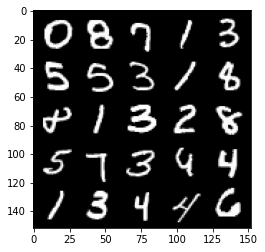

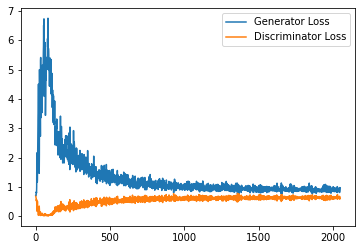

Step 41500: Generator loss: 0.9234662365913391, discriminator loss: 0.6252263422608375


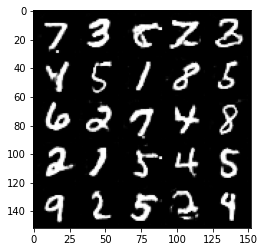

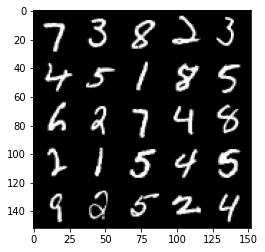

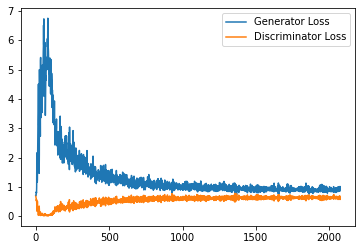

Step 42000: Generator loss: 0.9202298288345336, discriminator loss: 0.6301708740592002


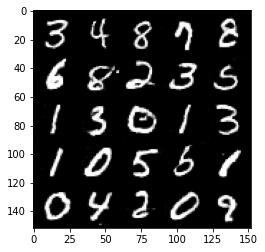

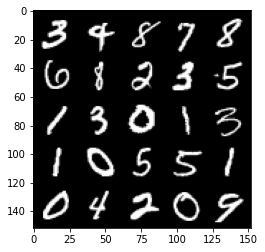

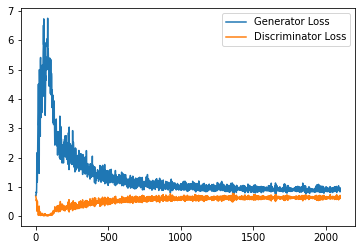

Step 42500: Generator loss: 0.9207002922296524, discriminator loss: 0.6261210465431213


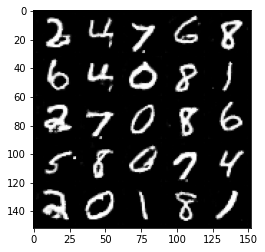

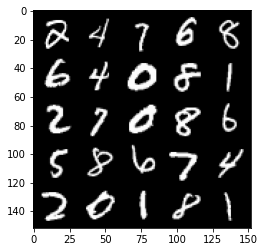

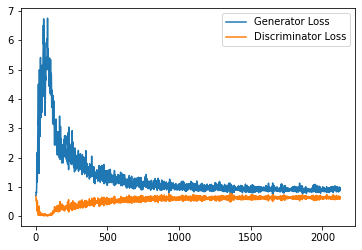

Step 43000: Generator loss: 0.9126122373342515, discriminator loss: 0.6274545335173607


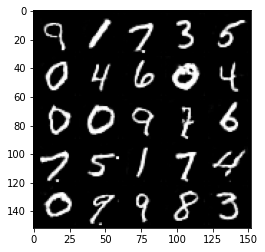

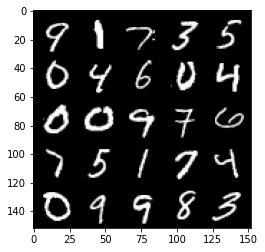

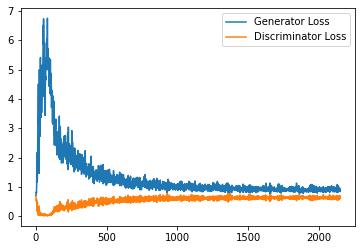

Step 43500: Generator loss: 0.9099101371765137, discriminator loss: 0.6274170930981636


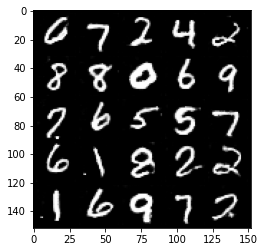

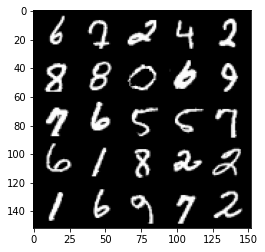

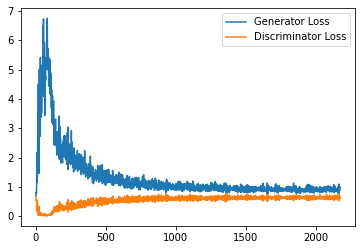

Step 44000: Generator loss: 0.9206111084222793, discriminator loss: 0.6259846848249435


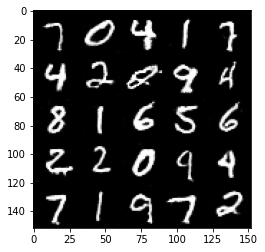

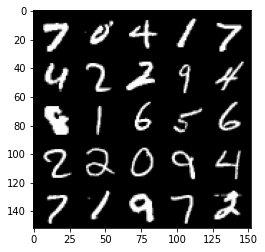

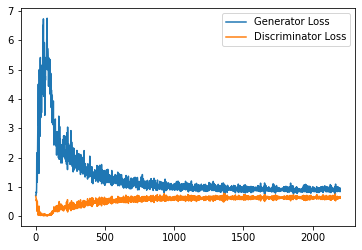

Step 44500: Generator loss: 0.9248541213274002, discriminator loss: 0.624622875213623


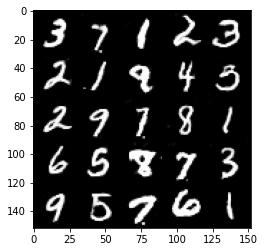

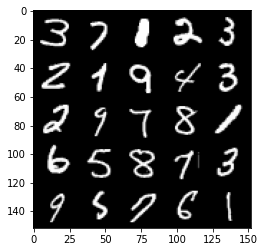

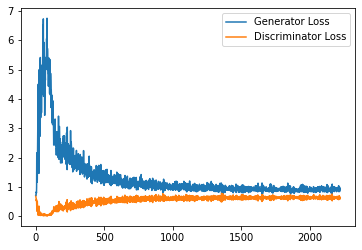

Step 45000: Generator loss: 0.9077910267114639, discriminator loss: 0.6258346218466758


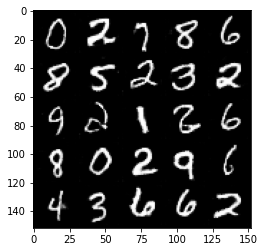

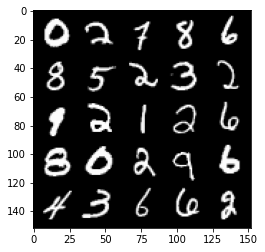

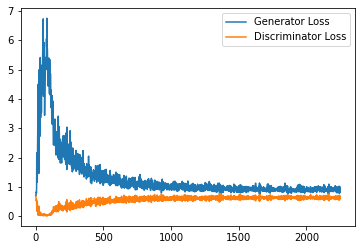

Step 45500: Generator loss: 0.9147290380001069, discriminator loss: 0.6210099810361862


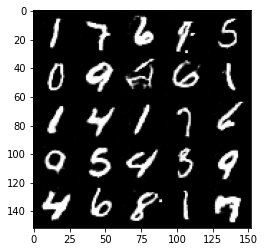

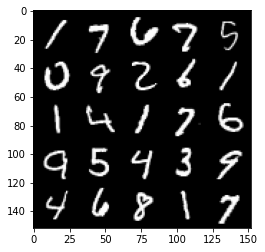

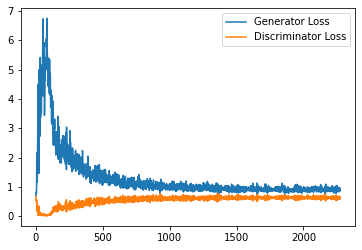

Step 46000: Generator loss: 0.910708765745163, discriminator loss: 0.6222799501419067


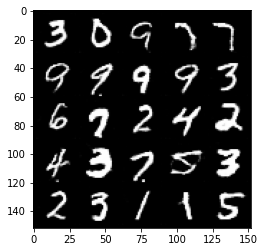

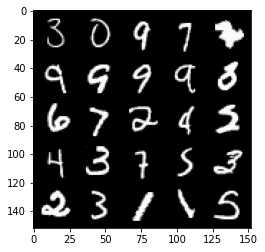

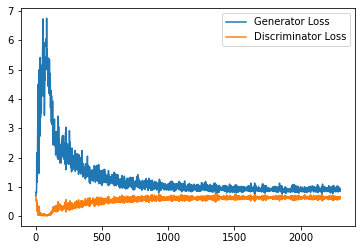

Step 46500: Generator loss: 0.9311996275186538, discriminator loss: 0.6158451870679855


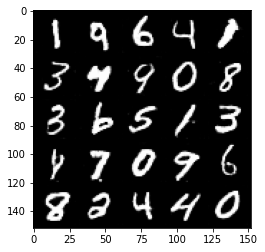

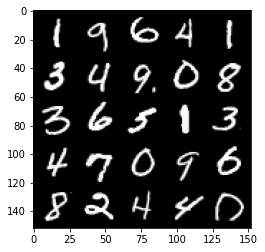

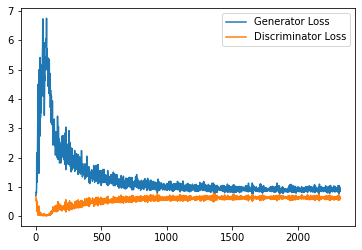

Step 47000: Generator loss: 0.9053996309041977, discriminator loss: 0.6221308313608169


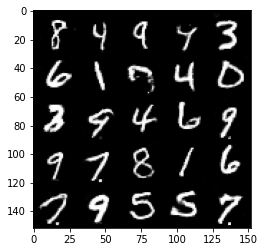

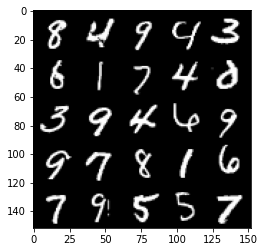

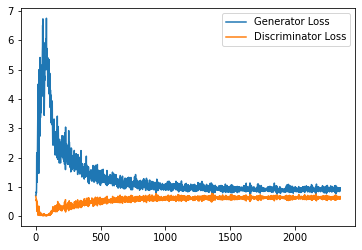

Step 47500: Generator loss: 0.9345884288549423, discriminator loss: 0.6186257048845291


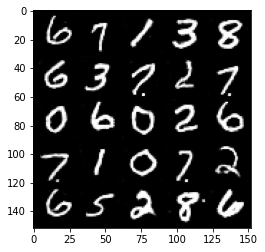

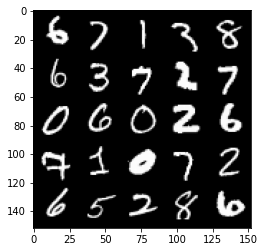

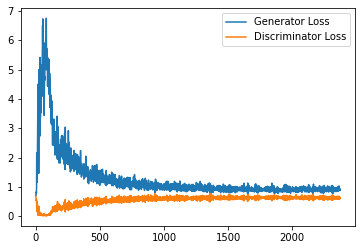

Step 48000: Generator loss: 0.9329574613571167, discriminator loss: 0.6170825247168541


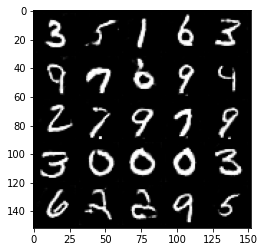

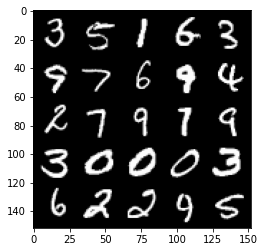

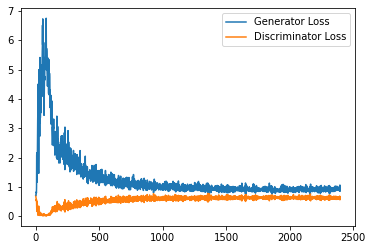

Step 48500: Generator loss: 0.9422671303749085, discriminator loss: 0.620674665749073


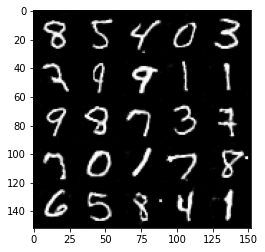

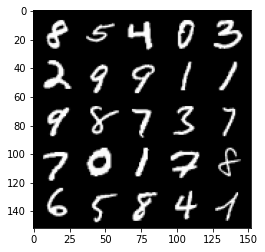

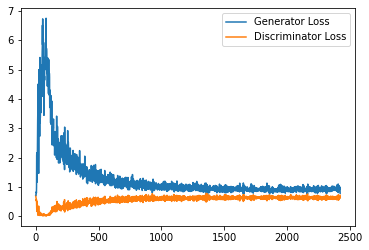

Step 49000: Generator loss: 0.9211106131076813, discriminator loss: 0.6139275522232056


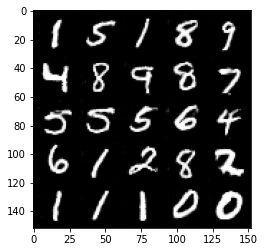

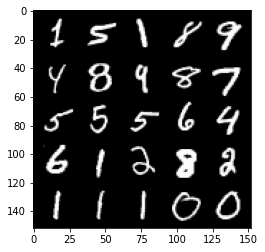

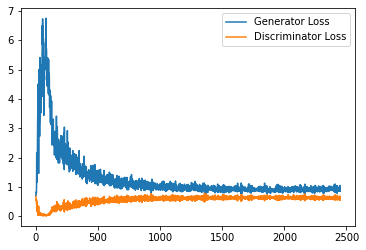

Step 49500: Generator loss: 0.9096404850482941, discriminator loss: 0.6215407129526138


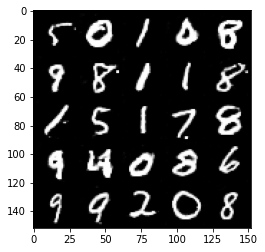

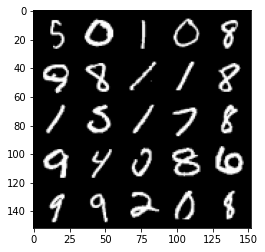

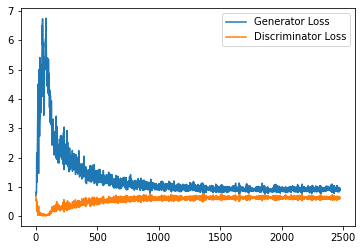

Step 50000: Generator loss: 0.9209274295568466, discriminator loss: 0.6187842313051224


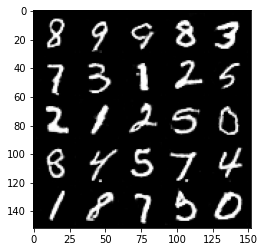

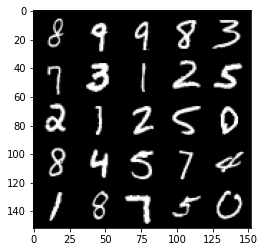

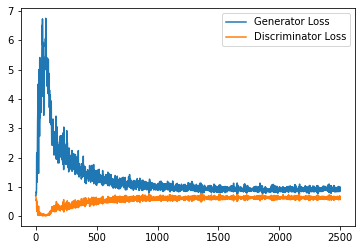

Step 50500: Generator loss: 0.9204978116750717, discriminator loss: 0.6190945048332215


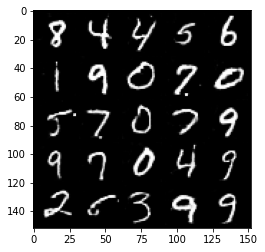

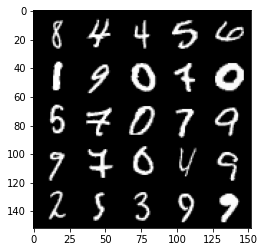

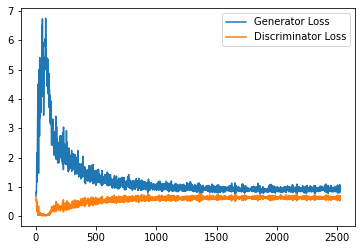

Step 51000: Generator loss: 0.9140598596334457, discriminator loss: 0.6173493752479553


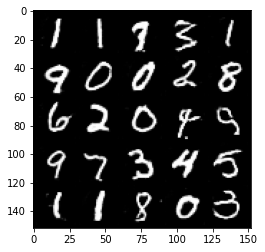

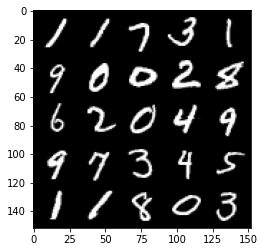

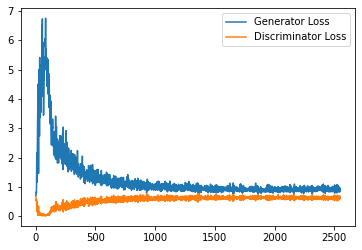

Step 51500: Generator loss: 0.9342456138134003, discriminator loss: 0.614750750541687


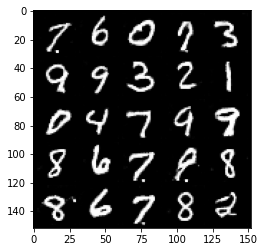

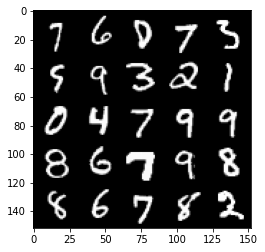

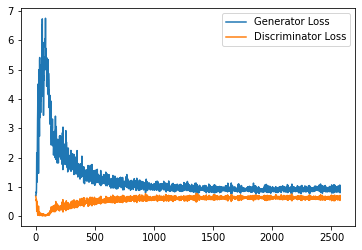

Step 52000: Generator loss: 0.9322090954780579, discriminator loss: 0.6141234301328659


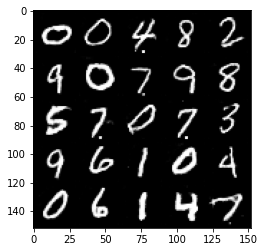

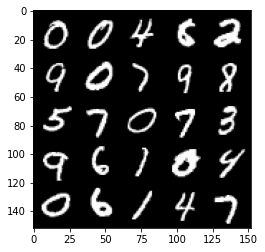

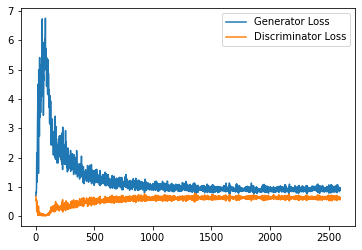

Step 52500: Generator loss: 0.9198792930841446, discriminator loss: 0.6111126253008843


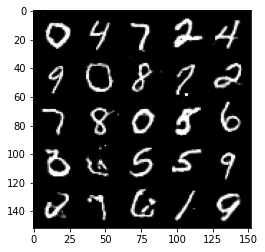

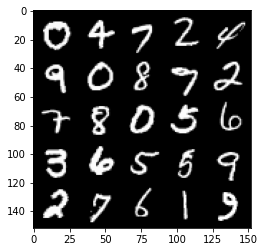

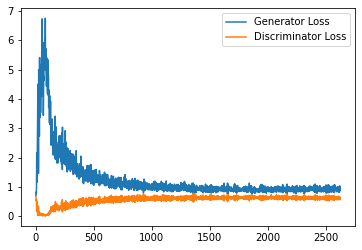

Step 53000: Generator loss: 0.9474182019233703, discriminator loss: 0.6164648515582085


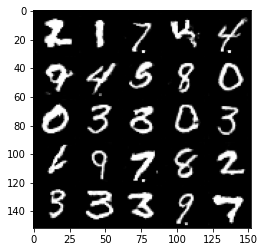

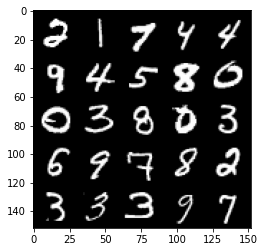

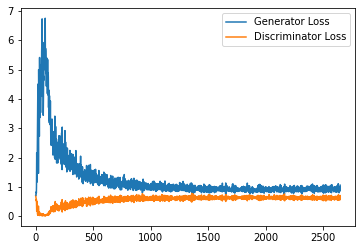

Step 53500: Generator loss: 0.9382810764312745, discriminator loss: 0.6132264003157616


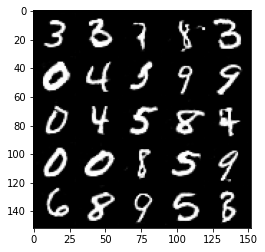

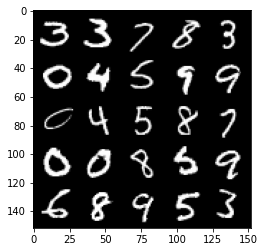

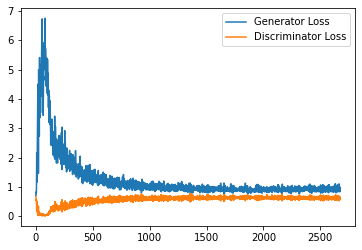

Step 54000: Generator loss: 0.9438434475660324, discriminator loss: 0.6131270745396614


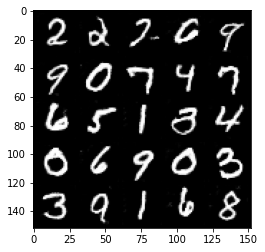

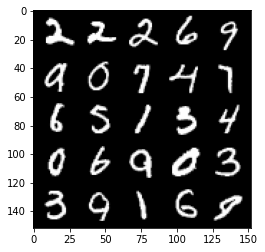

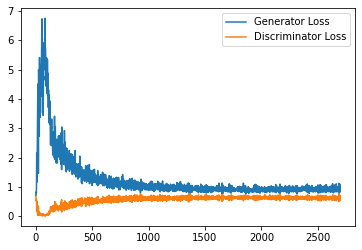

Step 54500: Generator loss: 0.9473549047708512, discriminator loss: 0.6059467493295669


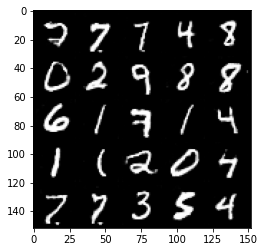

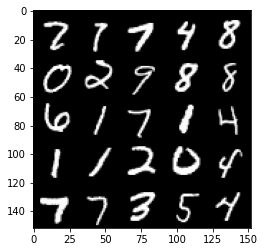

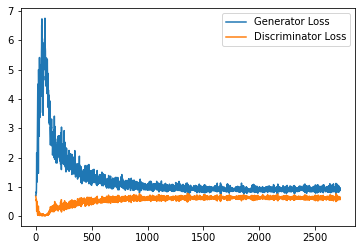

Step 55000: Generator loss: 0.9495394854545594, discriminator loss: 0.611787439763546


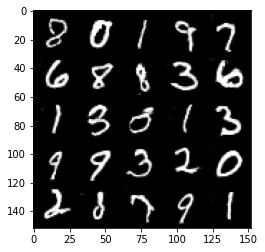

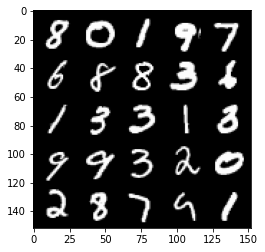

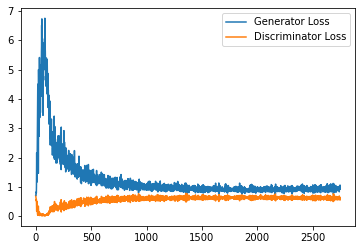

Step 55500: Generator loss: 0.9362752689123154, discriminator loss: 0.6131745793819428


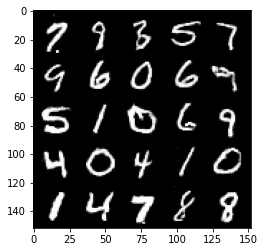

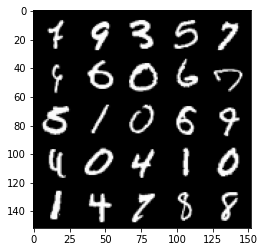

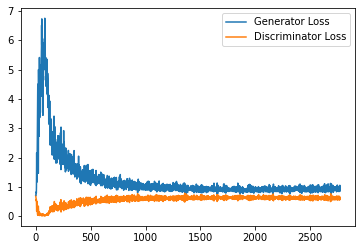

Step 56000: Generator loss: 0.9366783236265183, discriminator loss: 0.6090530185699463


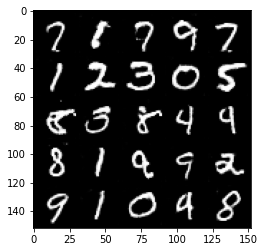

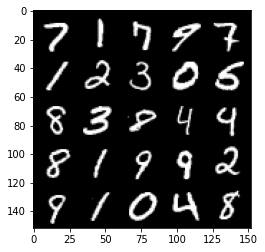

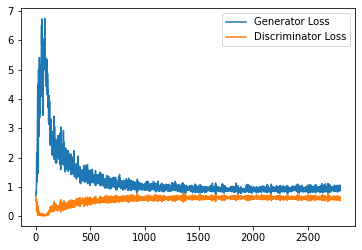

Step 56500: Generator loss: 0.9410353246927261, discriminator loss: 0.6044083310961723


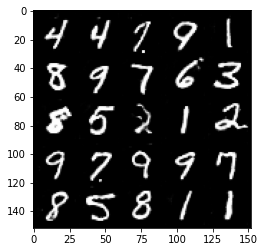

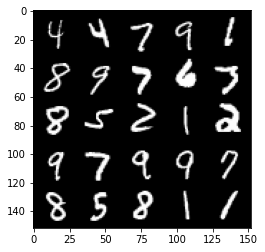

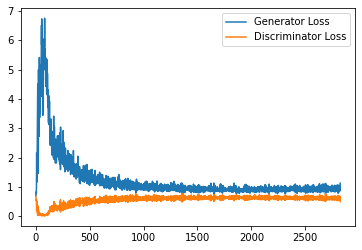

Step 57000: Generator loss: 0.9491363614797592, discriminator loss: 0.6125131124854087


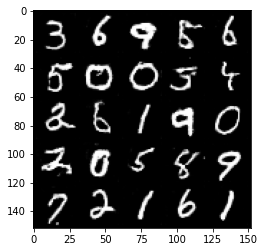

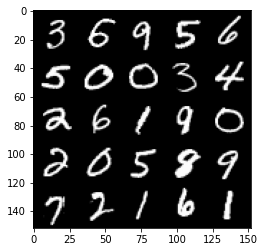

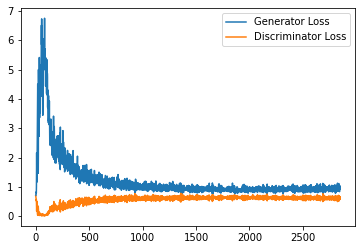

Step 57500: Generator loss: 0.9465817621946335, discriminator loss: 0.6133464975953102


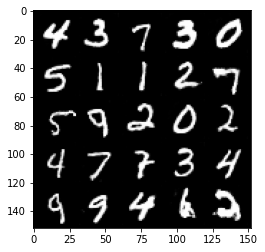

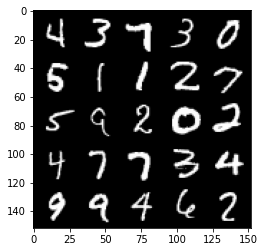

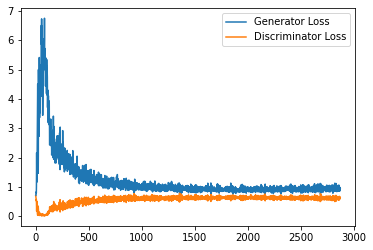

Step 58000: Generator loss: 0.9492866024971008, discriminator loss: 0.6053989813327789


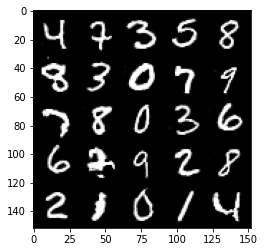

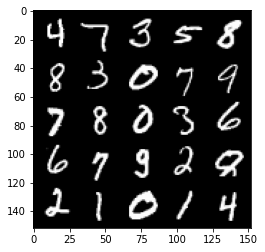

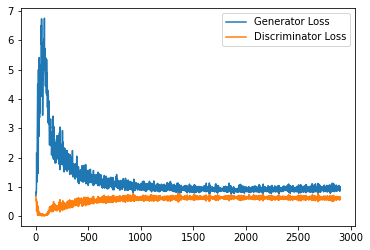

Step 58500: Generator loss: 0.9353430372476578, discriminator loss: 0.6063380290865898


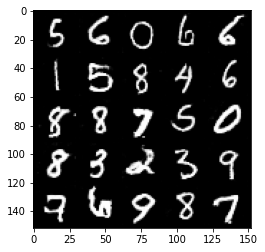

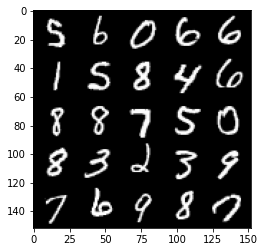

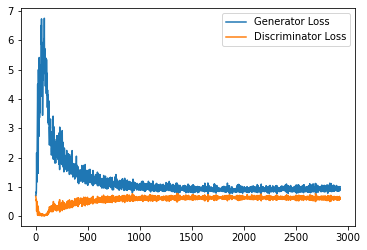

Step 59000: Generator loss: 0.9588505201339722, discriminator loss: 0.6091423301100731


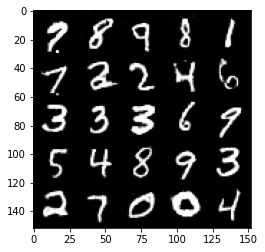

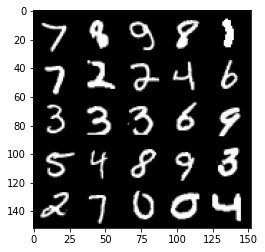

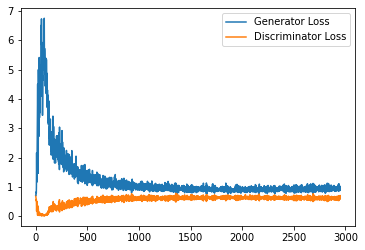

Step 59500: Generator loss: 0.9449211376905441, discriminator loss: 0.6040547817349434


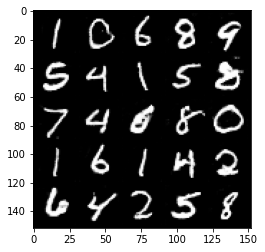

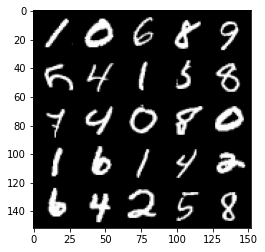

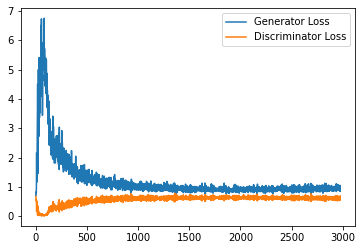

Step 60000: Generator loss: 0.9565148144960404, discriminator loss: 0.5999886094331741


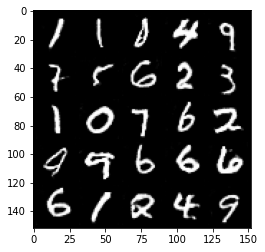

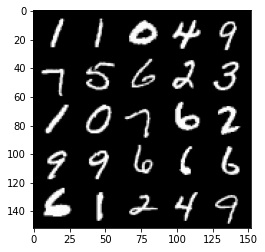

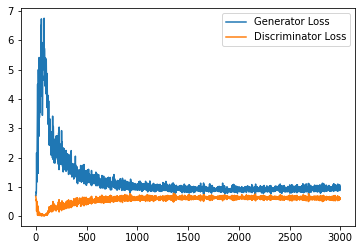

Step 60500: Generator loss: 0.9509610584974288, discriminator loss: 0.6066638293862343


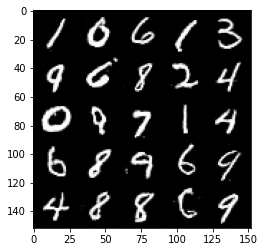

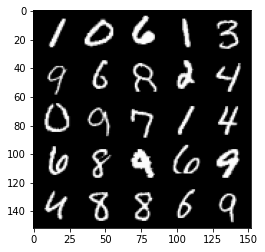

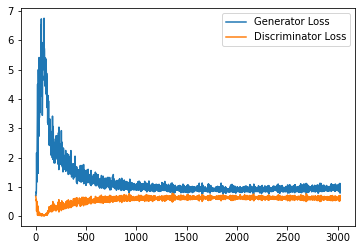

Step 61000: Generator loss: 0.9601793797016144, discriminator loss: 0.6048471707701683


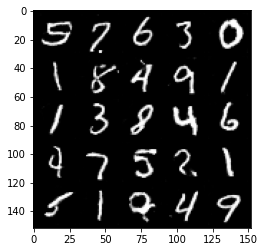

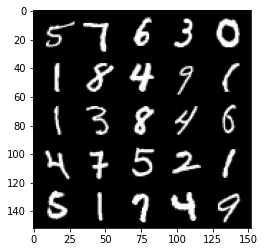

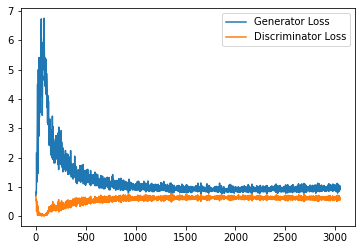

Step 61500: Generator loss: 0.9514169406890869, discriminator loss: 0.6031980292201042


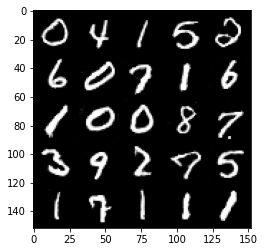

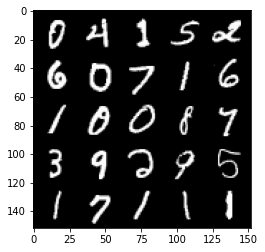

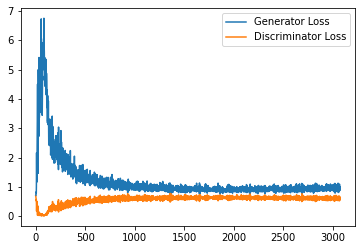

Step 62000: Generator loss: 0.9481925475597381, discriminator loss: 0.602306569814682


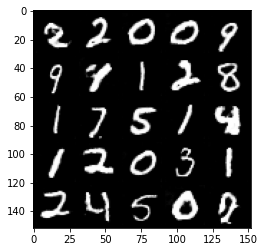

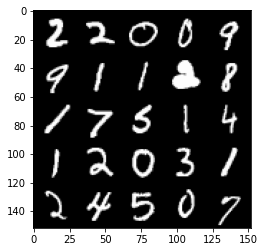

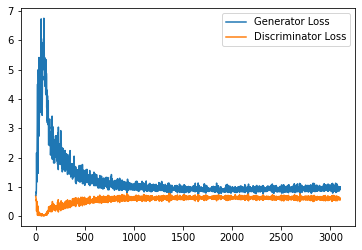

Step 62500: Generator loss: 0.9653842694759369, discriminator loss: 0.5973074945807457


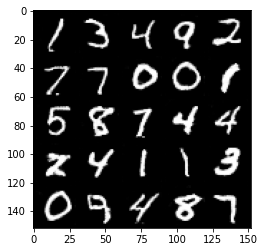

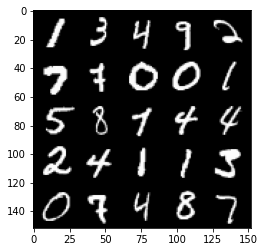

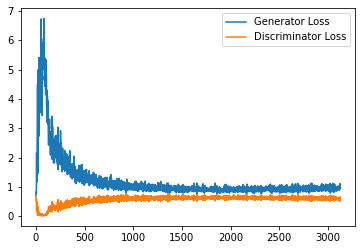

Step 63000: Generator loss: 0.9579541715383529, discriminator loss: 0.600170857846737


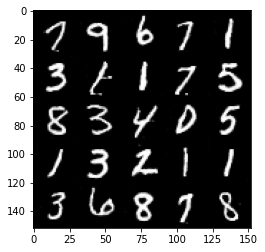

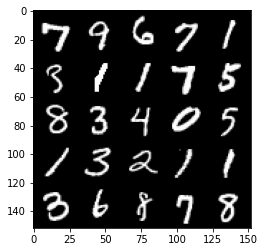

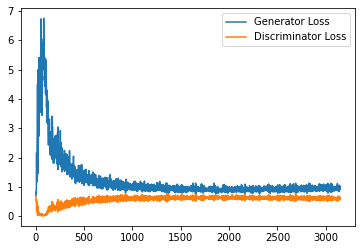

Step 63500: Generator loss: 0.9487143621444702, discriminator loss: 0.5998283171653748


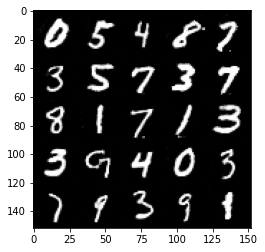

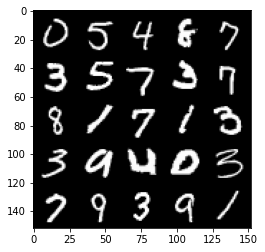

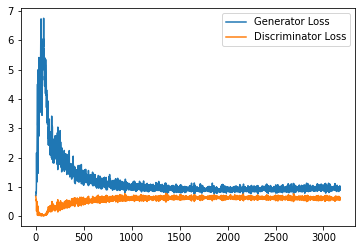

Step 64000: Generator loss: 0.9590950309038162, discriminator loss: 0.5994722329378128


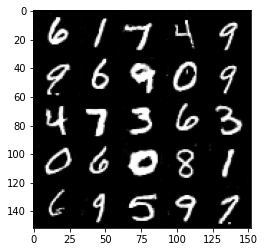

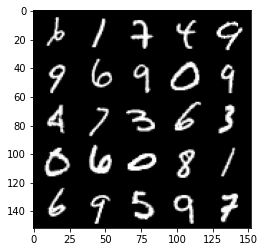

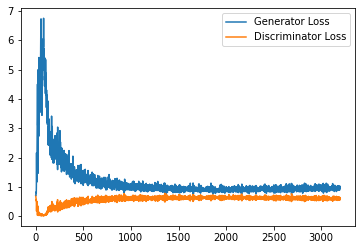

Step 64500: Generator loss: 0.9618477228879928, discriminator loss: 0.6001451281309128


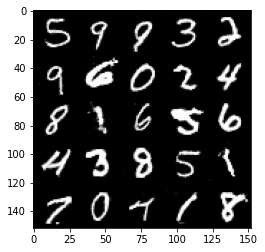

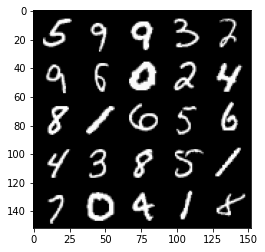

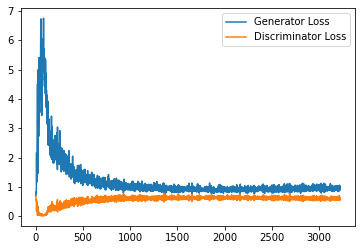

Step 65000: Generator loss: 0.9859921809434891, discriminator loss: 0.5954515175819397


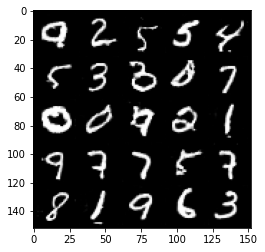

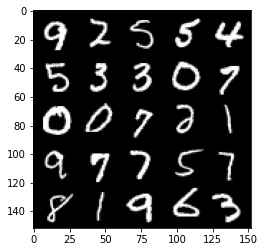

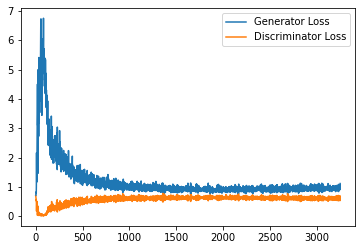

Step 65500: Generator loss: 0.959431934595108, discriminator loss: 0.6000330637097359


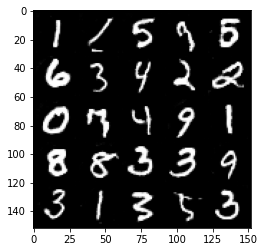

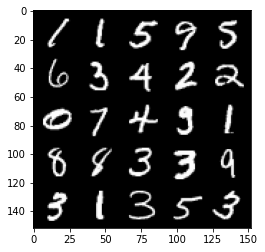

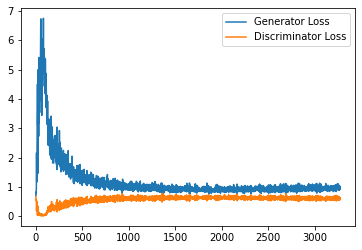

Step 66000: Generator loss: 0.9626383340358734, discriminator loss: 0.6028757804632187


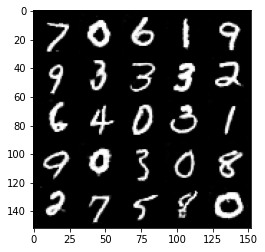

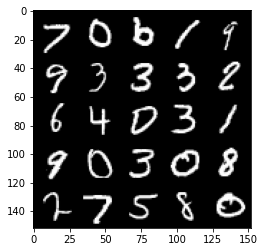

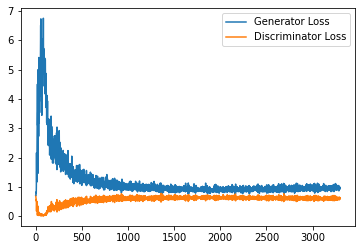

Step 66500: Generator loss: 0.9744639964103698, discriminator loss: 0.5994090965986252


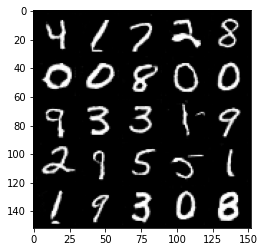

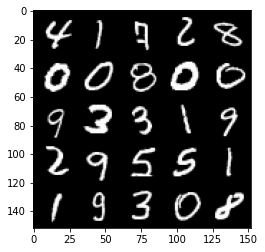

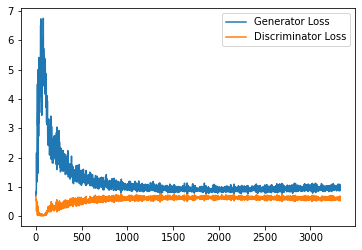

Step 67000: Generator loss: 0.9562238141298294, discriminator loss: 0.5992287241220474


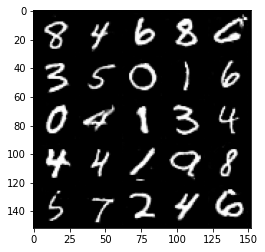

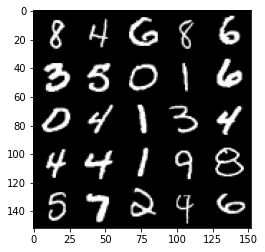

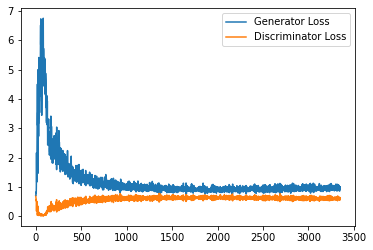

Step 67500: Generator loss: 0.9659021309614182, discriminator loss: 0.600602876484394


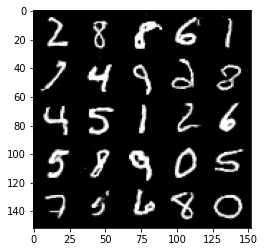

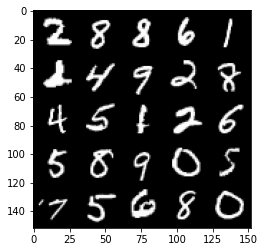

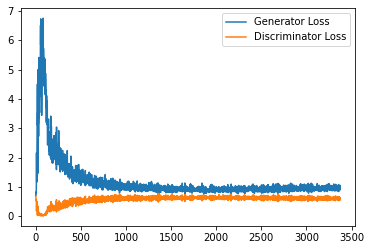

Step 68000: Generator loss: 0.9548869667053222, discriminator loss: 0.5991137995123863


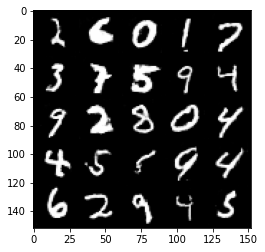

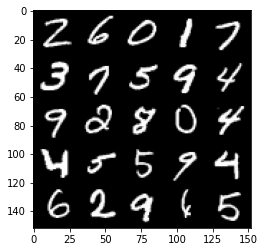

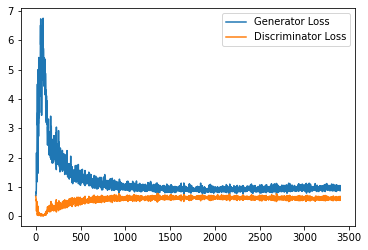

Step 68500: Generator loss: 0.9562593408823014, discriminator loss: 0.599308922469616


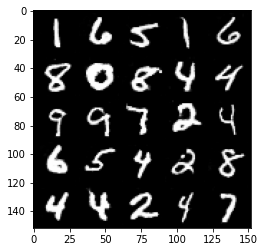

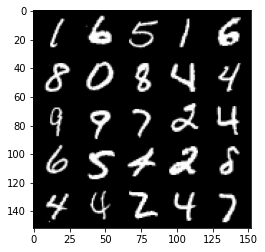

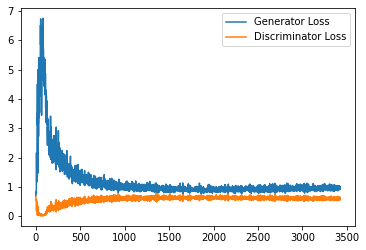

Step 69000: Generator loss: 0.9714859395027161, discriminator loss: 0.599671298623085


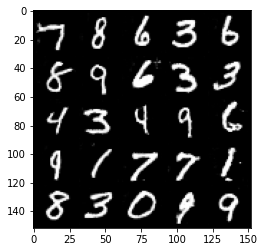

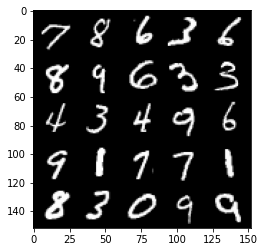

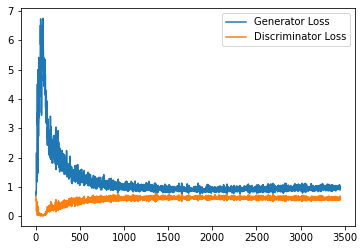

Step 69500: Generator loss: 0.9742035075426102, discriminator loss: 0.6007468572258949


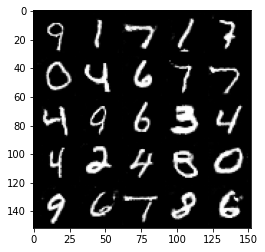

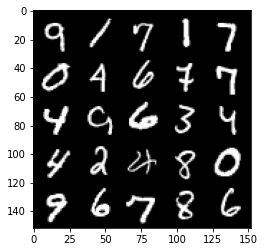

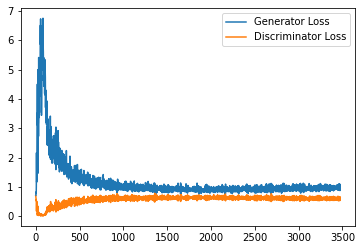

Step 70000: Generator loss: 0.9738391196727753, discriminator loss: 0.6028331562876701


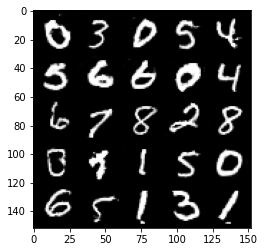

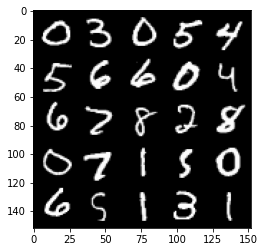

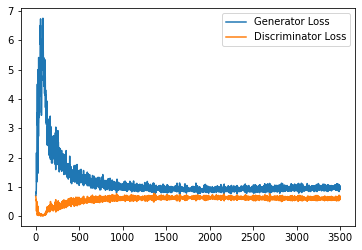

Step 70500: Generator loss: 0.9682520608901978, discriminator loss: 0.6006579931974411


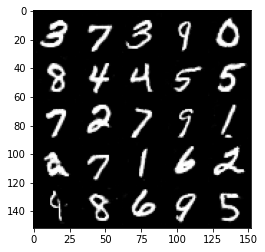

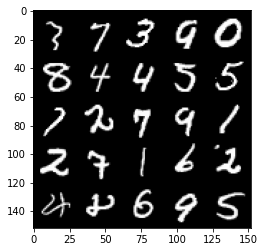

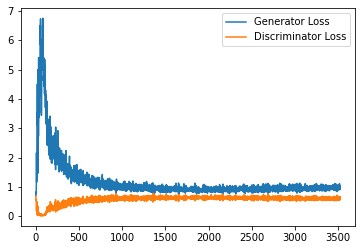

Step 71000: Generator loss: 0.9731203998327256, discriminator loss: 0.5974597918987274


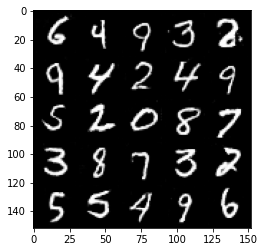

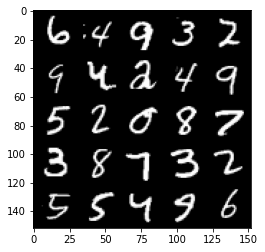

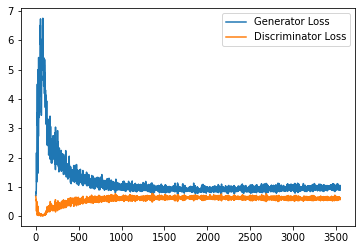

Step 71500: Generator loss: 0.9699546823501587, discriminator loss: 0.5997895699739456


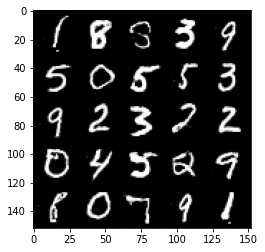

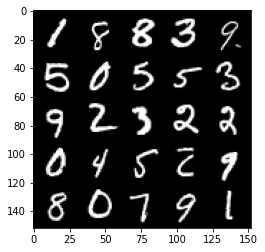

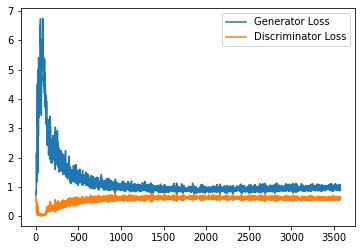

Step 72000: Generator loss: 0.9582337416410446, discriminator loss: 0.5981156352162361


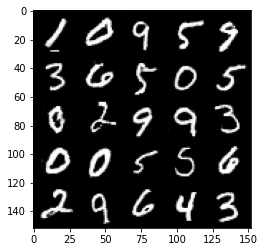

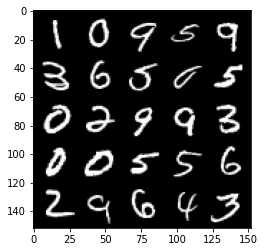

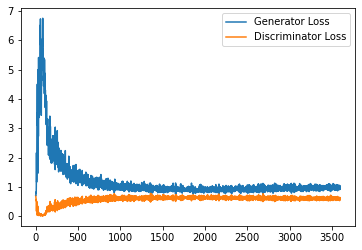

Step 72500: Generator loss: 0.9653489974737167, discriminator loss: 0.600165221273899


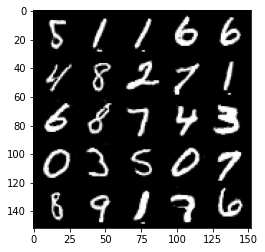

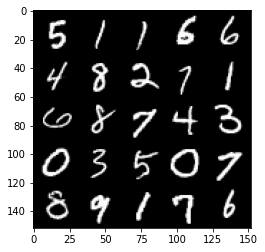

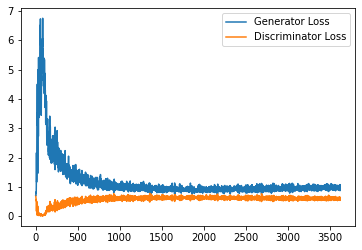

Step 73000: Generator loss: 0.9692364351749421, discriminator loss: 0.5967943608164787


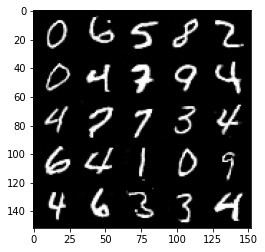

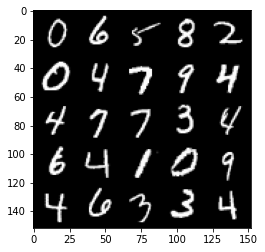

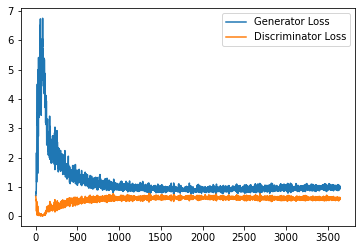

Step 73500: Generator loss: 0.9887488812208176, discriminator loss: 0.5973857980370522


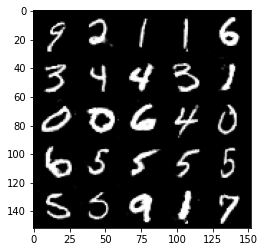

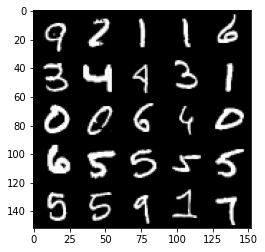

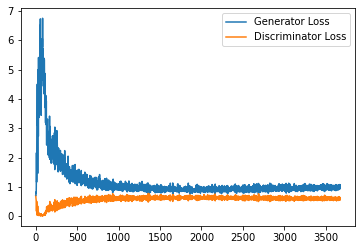

Step 74000: Generator loss: 0.974145921587944, discriminator loss: 0.6031231170296669


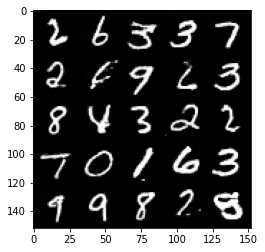

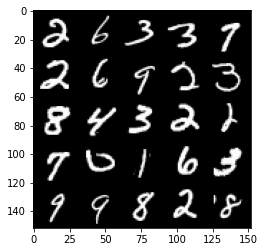

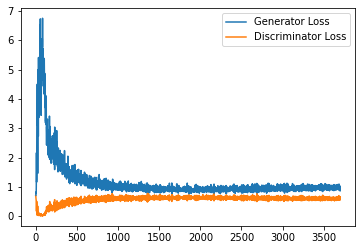

Step 74500: Generator loss: 0.971034783244133, discriminator loss: 0.5976960077285767


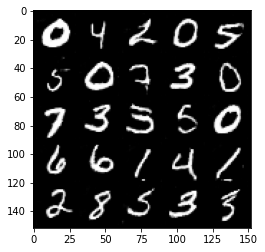

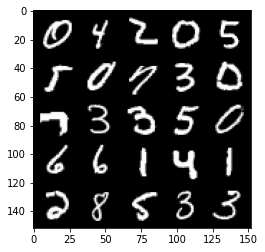

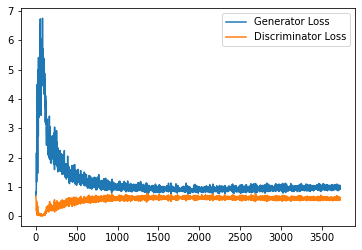

Step 75000: Generator loss: 0.9851204121112823, discriminator loss: 0.5938514883518219


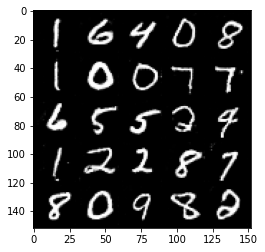

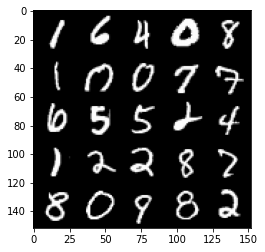

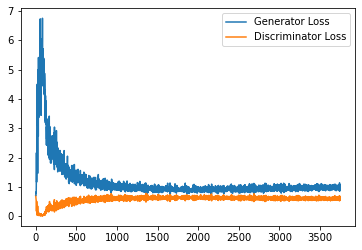

Step 75500: Generator loss: 0.9768646693229676, discriminator loss: 0.6003783792853356


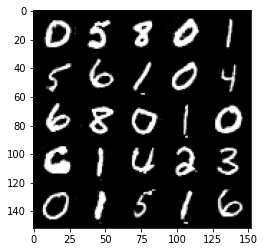

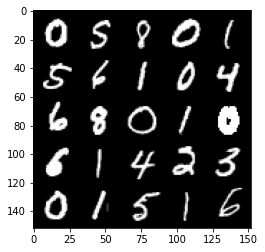

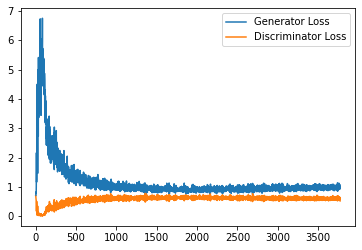

Step 76000: Generator loss: 0.9703274607658386, discriminator loss: 0.6021136729717255


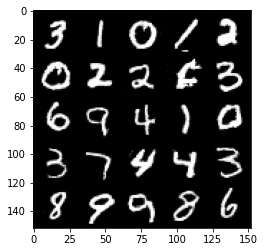

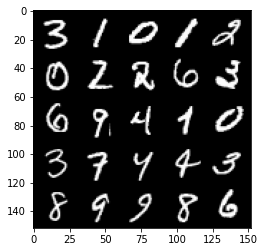

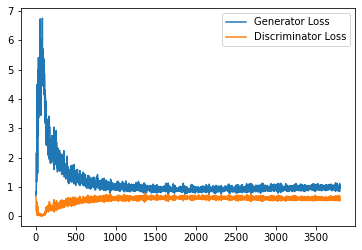

Step 76500: Generator loss: 0.982841285943985, discriminator loss: 0.5988389517068863


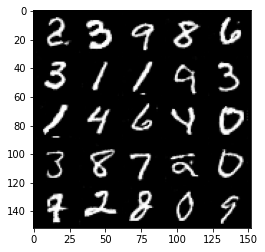

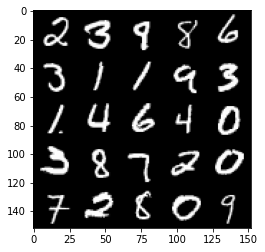

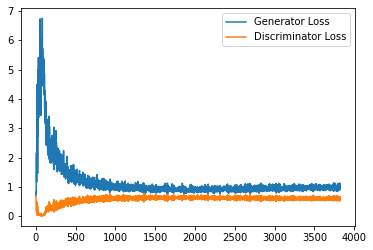

Step 77000: Generator loss: 0.9609141286611557, discriminator loss: 0.6007177191972732


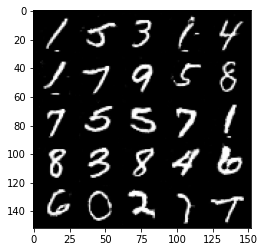

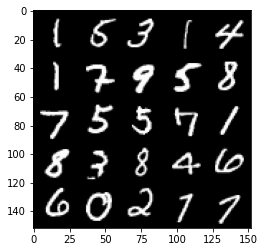

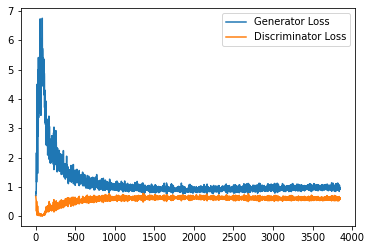

Step 77500: Generator loss: 0.9797532720565796, discriminator loss: 0.5969225494265556


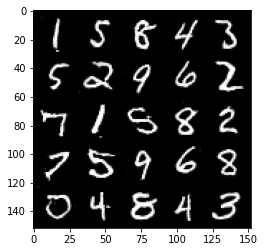

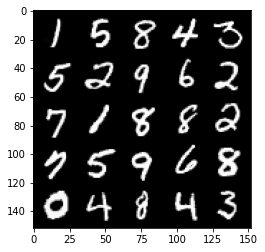

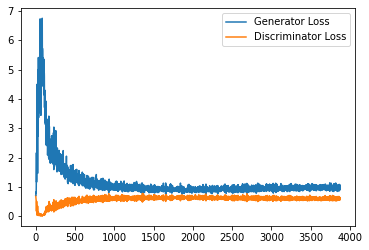

Step 78000: Generator loss: 0.9679857122898102, discriminator loss: 0.597937786102295


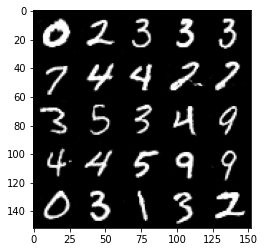

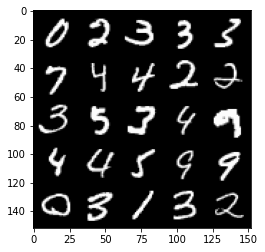

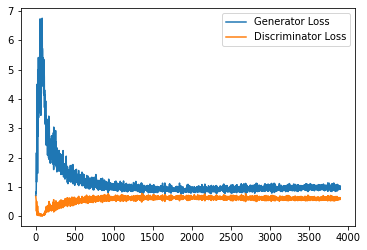

Step 78500: Generator loss: 0.9781664294004441, discriminator loss: 0.5984192934632301


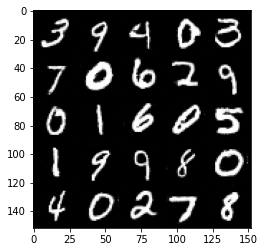

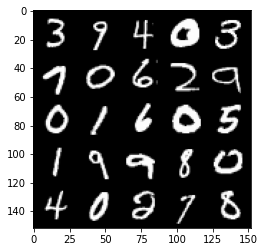

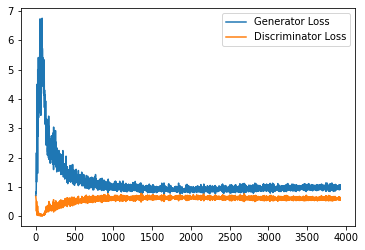

Step 79000: Generator loss: 0.9668547891378403, discriminator loss: 0.5993113473653794


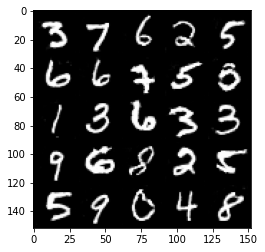

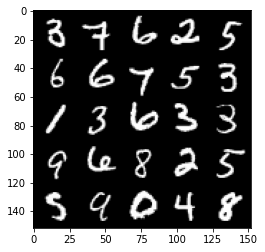

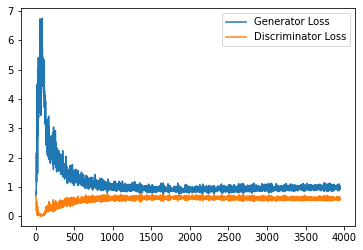

Step 79500: Generator loss: 0.9754545737504959, discriminator loss: 0.5987166168093682


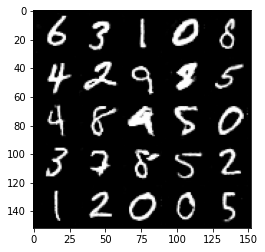

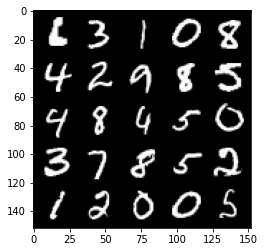

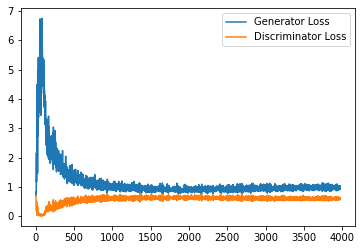

Step 80000: Generator loss: 0.9834150444269181, discriminator loss: 0.6025831130743027


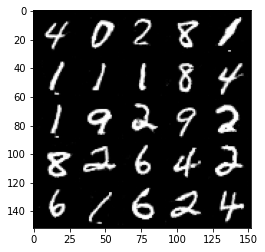

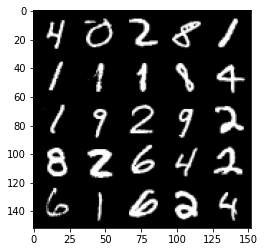

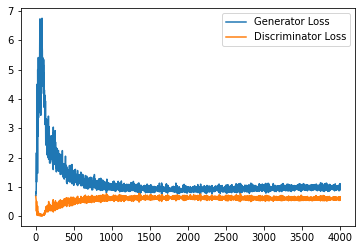

Step 80500: Generator loss: 0.9790510305166245, discriminator loss: 0.6006285055279732


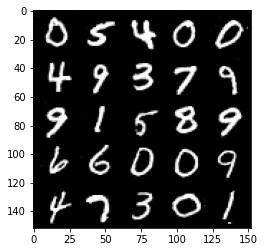

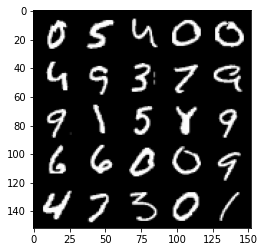

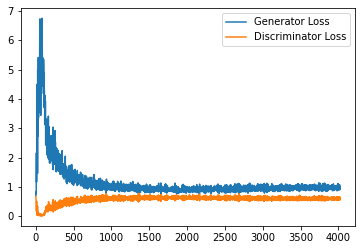

Step 81000: Generator loss: 0.9709461315870285, discriminator loss: 0.5994657223820686


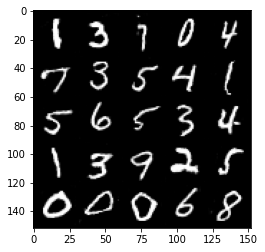

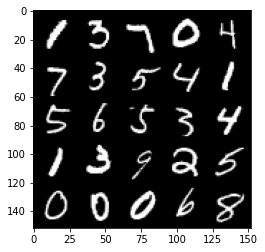

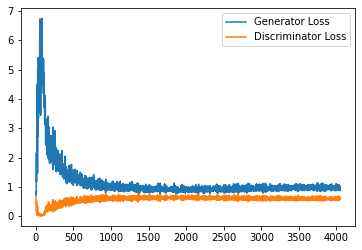

Step 81500: Generator loss: 0.9657244166135788, discriminator loss: 0.5988610175848007


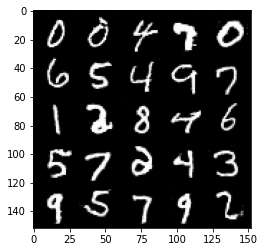

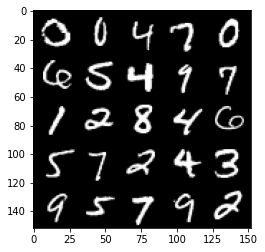

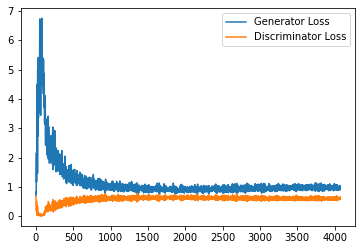

Step 82000: Generator loss: 0.9681545935869217, discriminator loss: 0.5978919633626938


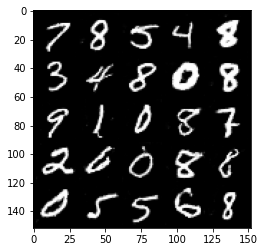

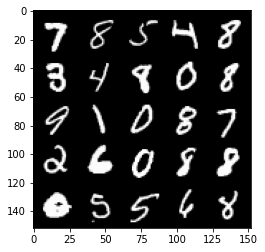

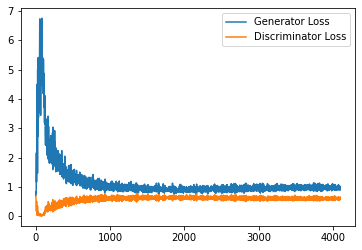

Step 82500: Generator loss: 0.9792388319969177, discriminator loss: 0.5979635582566262


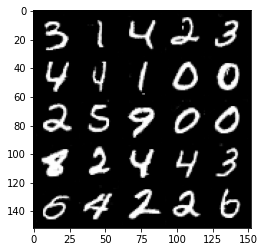

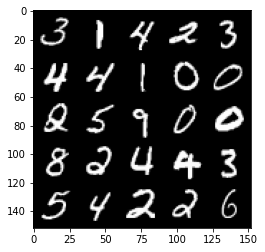

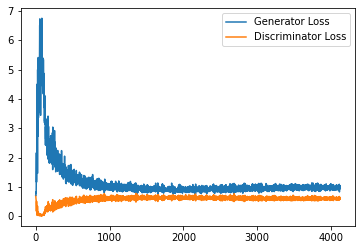

Step 83000: Generator loss: 0.9731747798919678, discriminator loss: 0.601647096157074


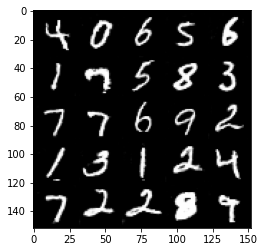

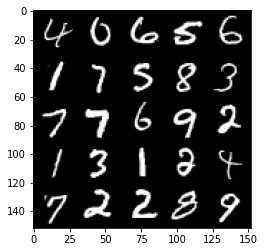

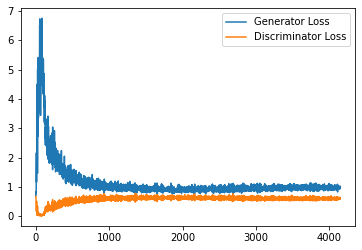

Step 83500: Generator loss: 0.9698797085285187, discriminator loss: 0.6027285489439964


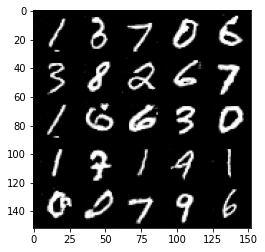

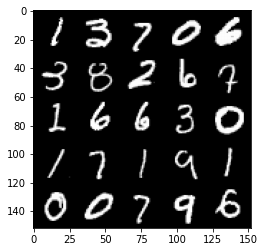

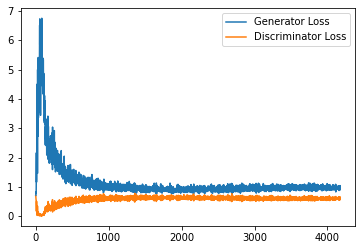

Step 84000: Generator loss: 0.9740337824821472, discriminator loss: 0.6021364185214043


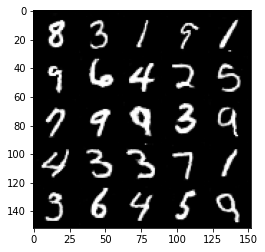

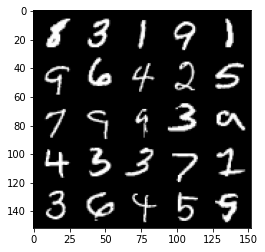

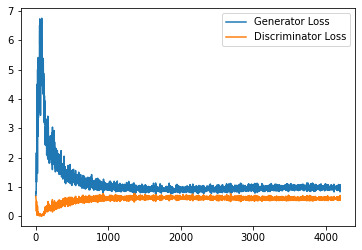

Step 84500: Generator loss: 0.9663612289428711, discriminator loss: 0.6020429012179375


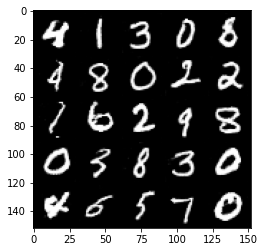

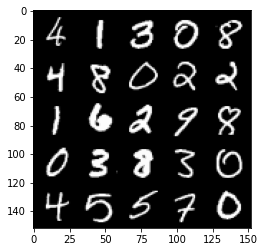

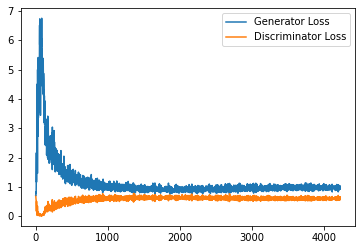

Step 85000: Generator loss: 0.9746315569877625, discriminator loss: 0.5991983518600464


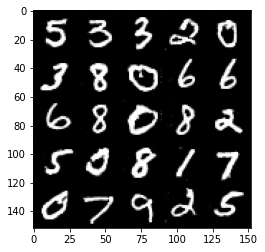

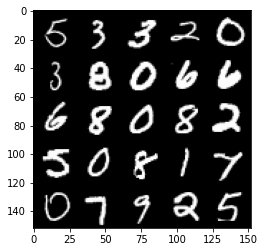

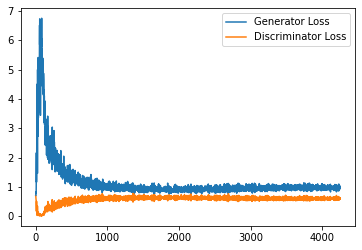

Step 85500: Generator loss: 0.9579055486917496, discriminator loss: 0.6019035271406173


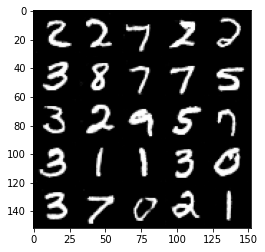

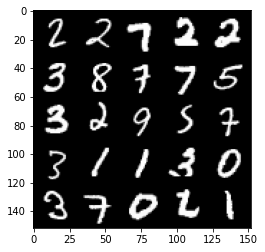

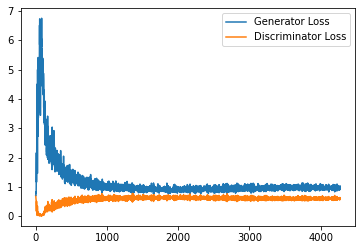

Step 86000: Generator loss: 0.978658714056015, discriminator loss: 0.6022887524962425


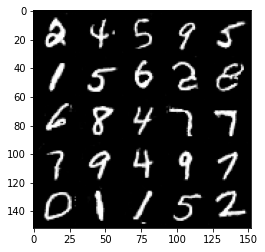

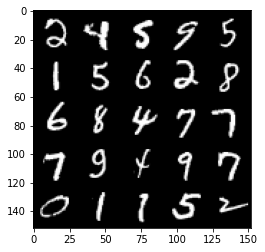

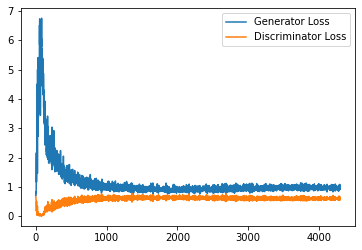

Step 86500: Generator loss: 0.9744578303098679, discriminator loss: 0.600308267891407


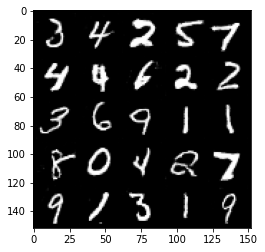

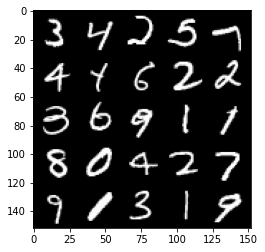

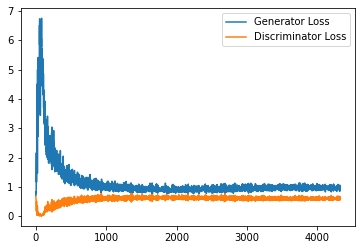

Step 87000: Generator loss: 0.9835714076757431, discriminator loss: 0.5990561721324921


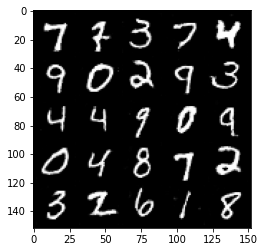

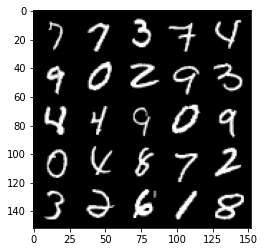

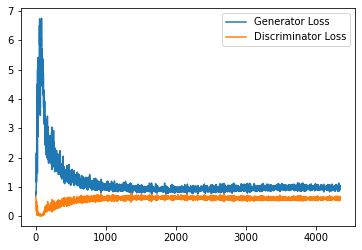

Step 87500: Generator loss: 0.9744757535457611, discriminator loss: 0.6043744890093803


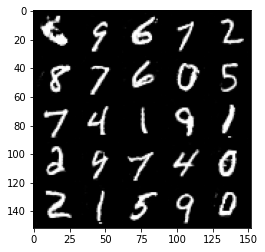

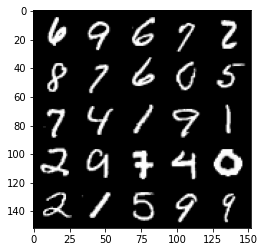

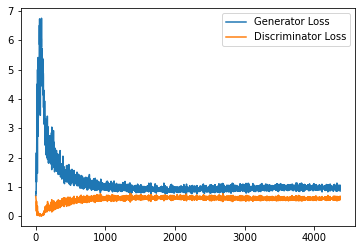

Step 88000: Generator loss: 0.9965671856403351, discriminator loss: 0.599311823606491


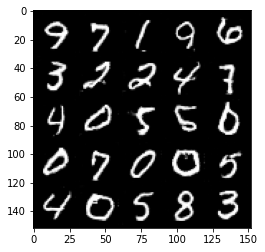

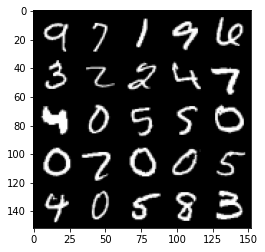

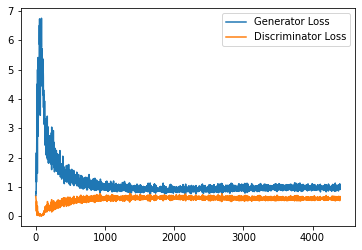

Step 88500: Generator loss: 0.9807738182544709, discriminator loss: 0.5968038745522499


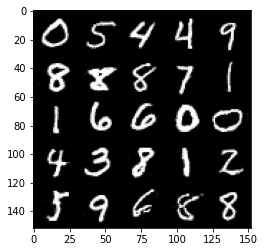

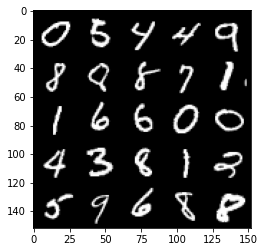

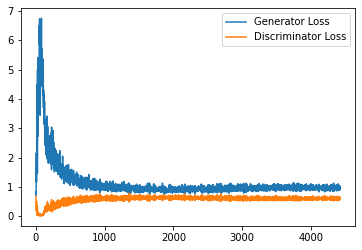

Step 89000: Generator loss: 0.9742301230430603, discriminator loss: 0.6039023276567459


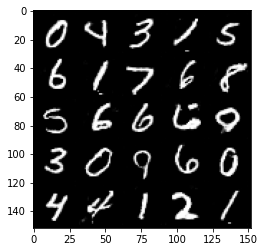

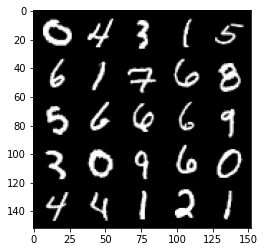

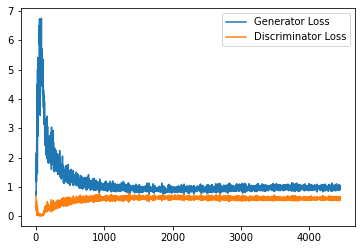

Step 89500: Generator loss: 0.9688738631010055, discriminator loss: 0.6033544236421585


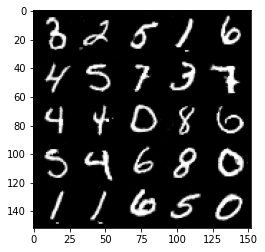

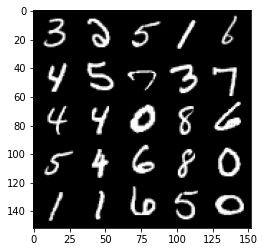

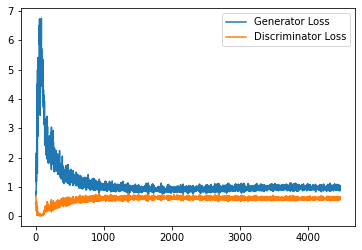

Step 90000: Generator loss: 0.9778482073545456, discriminator loss: 0.6017123100757599


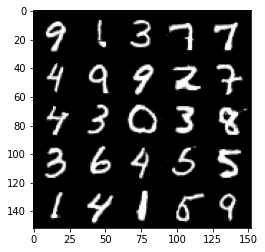

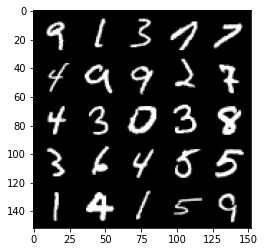

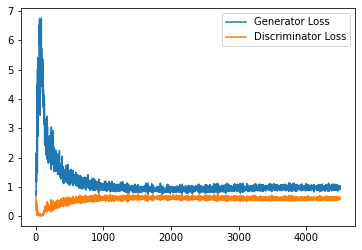

Step 90500: Generator loss: 0.97109246134758, discriminator loss: 0.5964509106874466


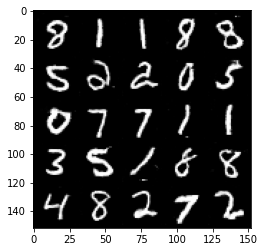

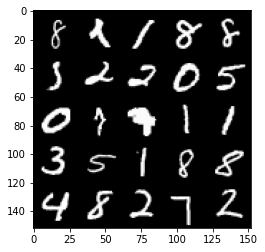

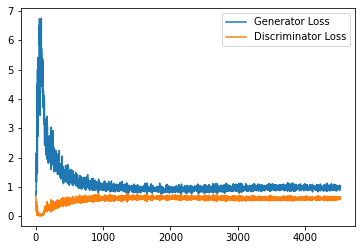

Step 91000: Generator loss: 0.973391548871994, discriminator loss: 0.609731581568718


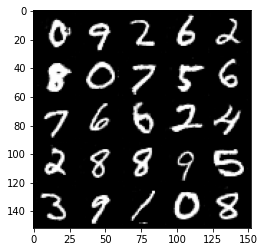

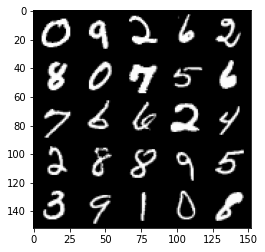

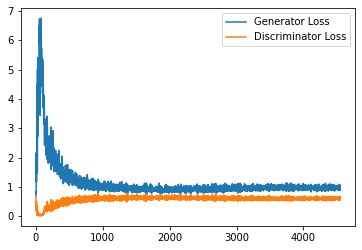

Step 91500: Generator loss: 0.9825534960031509, discriminator loss: 0.6008974058032036


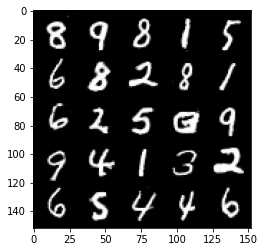

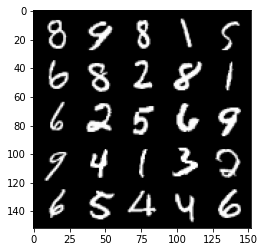

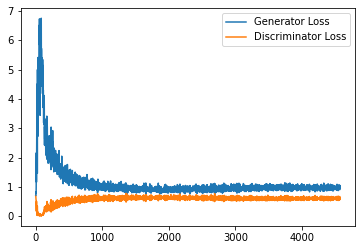

Step 92000: Generator loss: 0.9809657453298569, discriminator loss: 0.5968365177512169


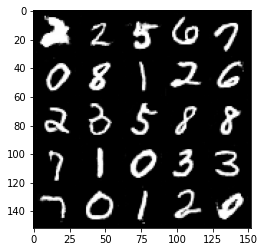

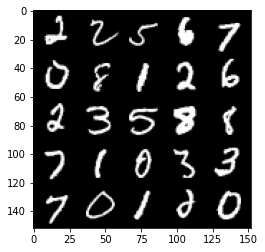

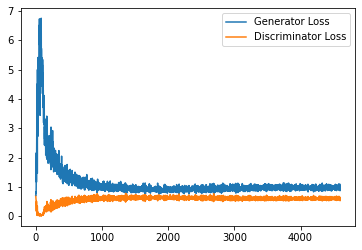

Step 92500: Generator loss: 0.9786700472831726, discriminator loss: 0.6017485617399215


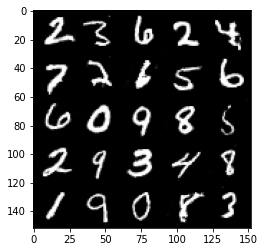

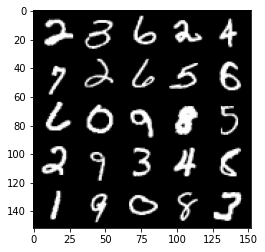

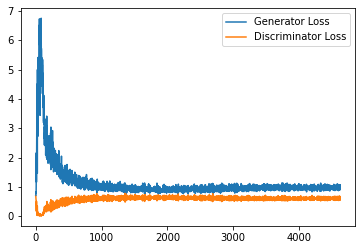

Step 93000: Generator loss: 0.9877459219694138, discriminator loss: 0.6024349468946457


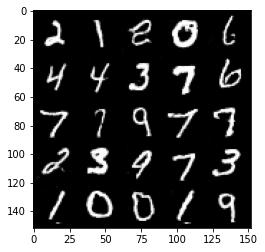

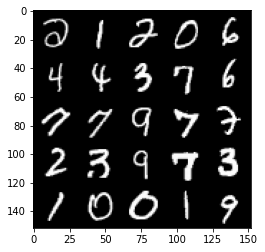

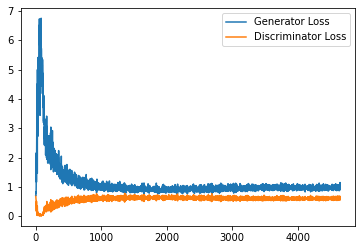

Step 93500: Generator loss: 0.977550347328186, discriminator loss: 0.6065882074832917


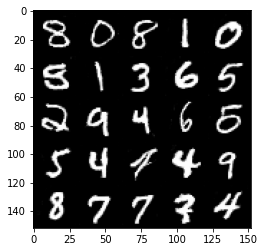

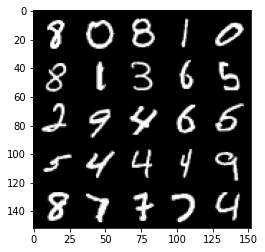

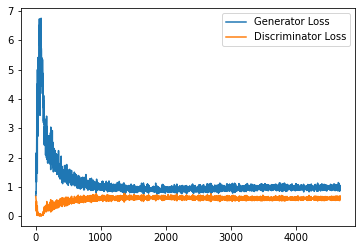

In [30]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = torch.cat((fake.float(),image_one_hot_labels.float()),1)
        real_image_and_labels = torch.cat((real.float(),image_one_hot_labels.float()),1)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [31]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

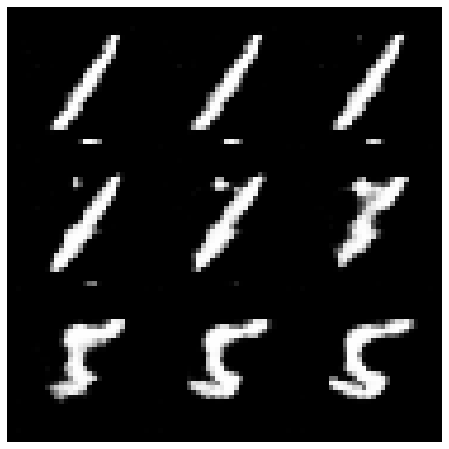

In [32]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

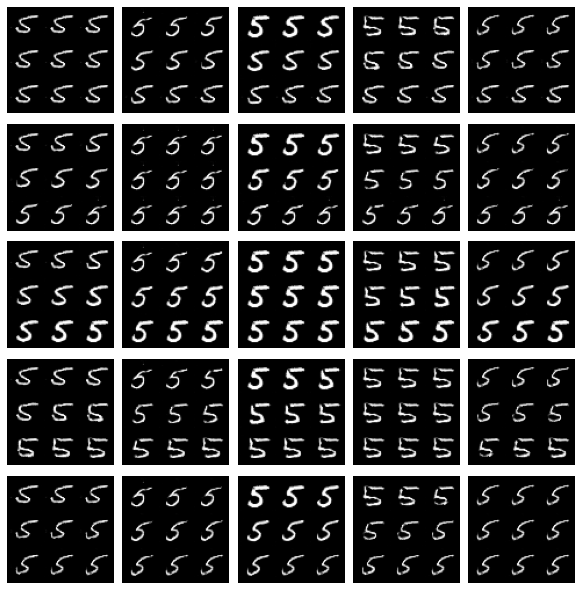

In [33]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()